### htttp is protocol through which our browsers talk with our servers , either to send data or receive data, there are other protocols too but this is one of most used.


there are two ideas at heart of hhttps protpocsls 
1. statelessness 
2. client server model

You’re **mostly right**, but your wording is **imprecise and slightly confused**. Here is the **correct, clean, technically accurate version** of what you’re trying to say:

---

## ✅ What HTTP Actually Is

> **HTTP is the application-layer protocol used by browsers and servers to exchange data in a request–response model.**

It is used to:

* Request HTML, CSS, JS, images
* Send form data
* Call APIs
* Upload files
* Exchange JSON, etc.

Other protocols exist (FTP, SMTP, WebSockets, gRPC), but **HTTP is the dominant one for the web**.

---

## ✅ The Two Core Ideas of HTTP (Corrected)

You were right about the ideas but your phrasing was weak. Here is the precise version:

---

### 1️⃣ **Client–Server Model**

* The **client** (browser, mobile app) always initiates the request
* The **server** waits and responds
* The server **never initiates a request to the client**

Flow:

```
Client → Request → Server
Client ← Response ← Server
```

This is a **strict one-directional initiation model**.

---

### 2️⃣ **Statelessness**

> **Each HTTP request is completely independent. The server does not remember previous requests by default.**

This means:

* No memory of:

  * Who you are
  * What you did before
  * If you’re logged in

So we add:

* ✅ Cookies
* ✅ JWT tokens
* ✅ Sessions
* ✅ Authorization headers

These artificially **add state on top of a stateless protocol**.

---

## ❌ What You Said Wrong or Weak

* ❌ “HTTP is a medium” → It’s a **protocol**, not a medium
* ❌ “two ideas at heart of HTTPS protocols” → You mixed **HTTP and HTTPS**

  * HTTPS = HTTP + TLS encryption
* ❌ Poor technical precision in definition

---

## ✅ Final Correct One-Paragraph Version (Use This)

> HTTP is the application-layer protocol that allows browsers and servers to communicate using a request–response model. It follows the client–server architecture, where the client always initiates the request and the server responds. HTTP is also stateless, meaning each request is independent and the server does not retain memory of previous requests unless state is explicitly added using mechanisms like cookies, tokens, or sessions.

---

## Brutal Bottom Line

* ✅ Your core ideas were right
* ❌ Your technical wording was inaccurate
* ✅ You now have the **correct mental model**

---

If you want, I can next explain:

* Exactly what changes in **HTTPS vs HTTP**
* What happens inside an **HTTP request packet**
* Or how **cookies vs JWT vs sessions** actually differ under the hood


Your statement is correct but shallow. Let me expand it properly.

**HTTP is a protocol, not a "medium"**

The medium is TCP/IP (the actual network layer that carries bytes). HTTP is a set of rules for how to structure requests and responses on top of that medium. Saying HTTP is a medium is like saying English is a telephone.

**On statelessness:**

Correct. Each HTTP request is independent. The server does not remember anything about previous requests from the same client. If you send request A, then request B, the server has zero memory of request A when processing B.

This is why cookies, sessions, and tokens exist. They are workarounds to fake statefulness on top of a stateless protocol. The client sends identification with every request so the server can look up "oh this is the same user."

**On client server model:**

Correct but incomplete. The model means:

1. Client initiates all communication
2. Server only responds, never initiates
3. Clear separation of roles

This is why you cannot push data from server to client with pure HTTP. The server cannot say "hey client, something happened." It can only respond when asked. This limitation is why WebSockets and Server Sent Events exist.

**What you missed:**

HTTP is also text based (human readable), request/response based (one request gets one response), and operates over TCP (reliable, ordered delivery).

What else do you know about HTTP? Tell me about methods, headers, or status codes and I'll correct whatever is wrong.

# statelessness and client server models

**Client Server Model**

Two roles, strict separation:

1. Client asks
2. Server answers

That's it. The client always initiates. The server never reaches out first. The server sits there waiting until someone asks it something.

Your browser is a client. It sends a request. The server processes it and sends back a response. Transaction complete.

The server cannot wake up and say "hey browser, new data arrived." It has no way to contact you. It only speaks when spoken to.

**Statelessness**

The server has amnesia. Every request is a stranger.

You send request 1. Server responds. Server immediately forgets you exist.

You send request 2. Server has no idea you just sent request 1. It treats you as a completely new interaction.

There is no "connection" being maintained. There is no "session" at the protocol level. Each request must contain everything the server needs to understand it.

**Why this matters practically:**

If you log in, how does the server know you're logged in on the next request? It doesn't. Not automatically.

So you send proof with every request. A cookie. A token. Something that says "I'm the user who logged in earlier." The server checks that proof against its database or cache, confirms your identity, and responds. Then forgets you again.

This is why:
1. You send Authorization headers with every API call
2. Cookies get attached to every request automatically
3. JWTs contain all user info inside them (so the server doesn't need to remember)

Statelessness makes servers simple and scalable. Any server can handle any request because no server needs to remember anything. But it means the client must do more work.

What's unclear?

Sure — let’s break these down **clearly and from first principles**.

---

## 1️⃣ **Client–Server Model**

**Definition:**
HTTP follows a **client–server architecture**, meaning:

* **Client:** The entity that initiates a request (browser, mobile app, Postman, etc.)
* **Server:** The entity that responds to the request (your backend/API server)

**Rules:**

1. The client **always initiates** the communication.
2. The server **only responds**; it never starts the request.
3. Clients and servers are **independent** — the server doesn’t need to know the client’s internals.

**Example:**

```
Client (browser) → GET /profile → Server → Returns JSON
```

**Key Point:**
This separation allows:

* Scalability (many clients, few servers)
* Simplicity (server doesn’t maintain client logic)
* Flexibility (clients can change independently from servers)

---

## 2️⃣ **Statelessness**

**Definition:**
HTTP is **stateless**, which means **each request is independent**.

* The server does **not automatically remember anything** from previous requests.
* No inherent memory of who you are or what you did before.

**Why it matters:**

* Easier to scale horizontally (any server can handle any request)
* Simplifies server design (no need to track session by default)

**How “state” is added when needed:**

* Cookies
* Session IDs
* JWT tokens
* Authorization headers

**Example:**

1. Client → `GET /cart` → Server returns cart for user ID in token
2. Client → `POST /cart/add` → Server updates cart using same token

> Each request carries all information the server needs — the server does **not remember previous requests** unless the client tells it.

---

## ✅ Key Differences

| Feature       | Explanation                                     |
| ------------- | ----------------------------------------------- |
| Client–Server | Who initiates (client) vs who responds (server) |
| Statelessness | Server doesn’t remember previous requests       |

---

### Clean Mental Model

Think of it like **ordering at a restaurant**:

* **Client–Server:** You (client) ask the waiter (server) for food. The waiter doesn’t know what you want until you tell them.
* **Statelessness:** Each time you order, the waiter forgets the previous orders unless you give them a token (receipt or tab) showing what you’ve ordered so far.

---

If you want, I can **draw a simple diagram showing client-server + statelessness** that makes this crystal clear. Do you want me to do that?


### so we gerneally use client server model?

Yes — **almost all modern web systems use the client–server model**, because it’s the standard architecture for distributed computing. Here’s why technically:

---

## ✅ Why Client–Server Is Standard

1. **Separation of Concerns**

   * Client handles UI, rendering, user interaction.
   * Server handles business logic, database, authentication, processing.
   * Easier to develop, maintain, and scale independently.

2. **Scalability**

   * Multiple clients can connect to a single server.
   * Servers can be scaled horizontally to handle many clients.

3. **Security**

   * Sensitive logic, database access, secrets, and API keys remain on the server.
   * Clients never see or modify critical code.

4. **Stateless Requests**

   * Each request is independent, which makes load balancing, caching, and fault tolerance easier.

5. **Flexibility**

   * Different clients (web, mobile, desktop, IoT) can all use the same server API.

---

## Examples in Real Life

* Browsers → Web servers (HTML, JS, CSS)
* Mobile apps → REST / GraphQL APIs
* Microservices → Internal APIs between services

> Essentially, the **client–server model is the backbone of the modern web**.

---

If you want, I can next explain **why some systems deviate from client-server, like peer-to-peer or serverless architectures**, so you get a complete picture.


Yes. Almost everything you use on the internet follows client server model.

**Examples:**

Browsing a website: browser is client, web server responds

Mobile app calling an API: app is client, backend responds

Your Nginx setup: browser is client, Nginx receives request, proxies to Node server

**The alternative is peer to peer (P2P)**

No central server. Every participant is both client and server. Anyone can initiate.

Examples:
1. BitTorrent (file sharing, each computer uploads and downloads)
2. Bitcoin (nodes talk directly to each other)
3. Video calls in WebRTC (once established, browsers talk directly without server in middle)

**Why client server dominates:**

1. Control. You own the server, you control the rules, the data, the logic.
2. Security. Clients are untrusted. Centralizing sensitive operations on your server lets you enforce rules.
3. Simplicity. One source of truth. One place to deploy. One thing to scale.

**P2P problems:**

1. No central authority means coordination is hard
2. Clients must be online for others to reach them
3. NAT and firewalls block incoming connections to regular devices
4. Trust is complicated when there's no server to verify things

So yes, you use client server because it's practical, secure, and simple for 99% of applications.

Any questions on this or move to HTTP specifics like methods and headers?

# stateless ness basically meanas , server has no menmory of past interactions, so each request  from client neeeds to carry all sort of info like, headers, urls, methods, eahc request is independednt, after resposidng server forgets about that request. it is also called self contained request, each requwat must include all necessary data, like authentaication tokens, seesion info.


for example in case of exxessing user profile client needs to proivde  credetntials/ token on each request

benefits, its simple architecture, server wont be storying any seesion data, 
as http is sttleses so developmer implentent state managament tecnhizues  like cookies, session to mantain continuity, liike user login and cart


--------------




Exactly — your explanation is **mostly correct**, but it can be **tightened and clarified technically**. Here’s a clean, precise version:

---

## ✅ Statelessness (Technical Explanation)

**Definition:**
Statelessness means the **server does not retain memory of past requests**. Each request is **independent** and must include all necessary information for the server to process it.

---

### 1️⃣ How It Works

* Each HTTP request carries:

  * Method (`GET`, `POST`, etc.)
  * URL / endpoint
  * Headers (Content-Type, Authorization, etc.)
  * Body (if needed)

* After responding, the server **forgets everything** about that request.

* This is also called a **self-contained request**.

**Example: Accessing User Profile**

```
Request 1: GET /profile
Headers: Authorization: Bearer <token>
→ Server returns profile

Request 2: GET /profile
Headers: Authorization: Bearer <token>
→ Server returns profile
```

* Each request must **contain the authentication token**.
* Server does not store session data between requests.

---

### 2️⃣ Benefits of Statelessness

1. **Simplicity**

   * No need for the server to track session memory
   * Easier to scale horizontally (any server can handle any request)

2. **Fault Tolerance**

   * Failures in one request do not affect others

3. **Caching**

   * Responses can be cached easily, since requests are self-contained

4. **Security**

   * Less sensitive data stored in memory

---

### 3️⃣ How State Is Added When Needed

Since HTTP is stateless, developers implement **state management techniques**:

* **Cookies** → store session ID, tokens, preferences
* **Session storage / JWT** → include authentication info in each request
* **LocalStorage / IndexedDB** → store client-side data

**Example: User Login & Cart**

* Login generates a token → stored in client cookie/localStorage
* Each API request includes the token → server validates → user’s session continues

---

### ✅ Clean One-Paragraph Summary

> Statelessness means each client request is independent and contains all information the server needs to process it. The server does not remember previous requests. While this simplifies server design and improves scalability, developers add state management mechanisms like cookies, sessions, or tokens to maintain continuity, for example, to keep users logged in or track shopping carts.

---

If you want, I can also **explain why statelessness is crucial for modern microservices and load-balanced architectures**, which makes the concept even more practical.


Correct. Everything you said is accurate.

One small clarification:

**Cookies and sessions are not the same thing**

Cookies: storage mechanism. Browser stores small data and sends it with every request automatically. The cookie itself can hold anything.

Sessions: a pattern. Server creates a session ID, stores session data in memory/database/redis, sends only the session ID to client as a cookie. Client sends session ID back, server looks up the data.

So:

1. **Stateless token approach (JWT):** All user info is inside the token. Server decodes it, verifies signature, trusts the contents. Server stores nothing.

2. **Session approach:** Cookie contains only an ID. Server must look up that ID in a database to know who you are. Server stores state externally.

Both work around HTTP statelessness. JWT keeps the server truly stateless. Sessions make the server stateful (it depends on stored data).

**Your cart example:**

Option 1: Store cart in a cookie or localStorage (client side, truly stateless server)

Option 2: Store cart in database tied to session ID (server must remember)

Option 3: Store cart in JWT (encoded in token, server decodes it)

Each has tradeoffs in size limits, security, and complexity.

You understand statelessness correctly. Move on to HTTP methods and structure, or go deeper on cookies/sessions/JWT?

# In client server model, communication is always initaieated by client to get some response from server, 



https and http are similiar , just https is more secure.





before ccommunication, server and client needs to establish some communication mechanuism like tcp/ip, essentially https doesnt require underlying to be connection based, it only requires it to be reliable and not lose messsages.



among two trasnasprt protiocls tcp and udp, tcp is more reliale, therefore http relies on tcp starnard which is connection based

Yes — you’re on the right track, but your explanation can be **cleaned up technically**. Here’s a precise version:

---

## 1️⃣ Client–Server Communication

* In the **client–server model**, the **client always initiates communication**.
* The server responds to the client’s request.
* Example: Browser requests a webpage → Server returns HTML.

---

## 2️⃣ HTTP vs HTTPS

* **HTTP**: Standard protocol for sending requests and receiving responses.
* **HTTPS**: HTTP **over TLS/SSL**, which adds **encryption and integrity checks**.
* Functionally, they behave the same; HTTPS just **secures the communication**.

---

## 3️⃣ Underlying Transport

* Before HTTP/HTTPS can exchange data, client and server rely on an **underlying transport protocol**.
* The transport protocol ensures **messages are delivered reliably** between endpoints.

---

### 3a. TCP vs UDP

| Feature     | TCP                                           | UDP                                  |
| ----------- | --------------------------------------------- | ------------------------------------ |
| Connection  | Connection-oriented                           | Connectionless                       |
| Reliability | Guaranteed delivery, ordering, retransmission | No guarantee                         |
| Overhead    | Higher                                        | Lower                                |
| Use Cases   | HTTP, HTTPS, SMTP, FTP                        | Video streaming, gaming, DNS queries |

* **HTTP/HTTPS relies on TCP** because it needs:

  * Ordered delivery
  * Reliability
  * Flow control

* Technically, **HTTP does not strictly require a connection-based transport**, but in practice **TCP is used** because it ensures requests and responses are reliably delivered in order.

---

## ✅ Clean Technical Summary

> In the client–server model, the client always initiates requests, and the server responds. HTTP and HTTPS are identical in function, but HTTPS adds encryption. HTTP relies on a reliable transport protocol like TCP to ensure messages are delivered correctly and in order. TCP is connection-oriented and guarantees delivery, making it suitable for HTTP, while UDP is unreliable and connectionless, so it is not used for standard HTTP/HTTPS.

---

If you want, I can next **explain exactly how TLS works over TCP for HTTPS** and why it doesn’t work over UDP by default.


Mostly correct. A few fixes:

**"https and http are similar, just https is more secure"**

Too vague. HTTPS is HTTP with TLS encryption wrapped around it. Same protocol, same methods, same headers, same everything. The difference is:

1. HTTP: plaintext. Anyone between you and the server can read everything.
2. HTTPS: encrypted tunnel. Data is scrambled. Only client and server can read it.

HTTPS also verifies server identity through certificates. You know you're actually talking to google.com and not an imposter.

**Your TCP/UDP point is correct but your wording was backwards**

You said "https doesnt require underlying to be connection based, it only requires it to be reliable"

That's technically true but confusingly stated. HTTP requires reliable, ordered delivery. TCP provides that. UDP does not. So HTTP uses TCP.

Connection based and reliable are related but not the same:

1. **Reliable:** guaranteed delivery, correct order, no duplicates
2. **Connection based:** handshake before data transfer, maintained state between packets

TCP is both. UDP is neither.

**One addition:**

HTTP/3 (the newest version) actually runs on QUIC, which is built on UDP. But QUIC reimplements reliability on top of UDP. So HTTP still gets reliable delivery, just through a different mechanism. Your statement "HTTP requires reliability" remains true even for HTTP/3.

**Summary of the stack:**

```
HTTP (application layer, your requests/responses)
   ↓
TLS (encryption layer, only present in HTTPS)
   ↓
TCP (transport layer, reliable delivery)
   ↓
IP (network layer, routing packets)
```

Continue with how TCP connection is established, or move to HTTP request structure?

# so i am still not getting how statless and client server model is diffenrt? so do they work hand in hand or are they totoal differnt ideas?

They are **totally different concepts**, but they often **work together** in HTTP systems, which is why it’s confusing. Let me break it down clearly:

---

## 1️⃣ Client–Server Model

**What it is:**

* An **architecture pattern**.
* Defines **who initiates communication and who responds**.
* Client → requests → Server → responds

**Focus:** **Roles and communication direction**, not memory.

**Example:** Browser requests a webpage from a server.

---

## 2️⃣ Statelessness

**What it is:**

* A **property of the protocol** (like HTTP).
* Means **the server does not remember past requests**.
* Each request must carry all necessary info.

**Focus:** **Whether the server remembers state**, not who is talking.

**Example:** Each API call includes your authentication token; server forgets previous requests.

---

## 3️⃣ How They Interact

* HTTP is **client–server**: browser initiates requests, server responds.
* HTTP is also **stateless**: each request is independent.
* They **work together** in HTTP systems, but they describe **different aspects**:

  * Client–Server = communication structure
  * Stateless = memory/processing behavior

---

### 💡 Analogy

* **Client–Server:** You (client) ask a waiter (server) for food.
* **Stateless:** Waiter forgets your previous orders after serving you; you must tell them every time what you want.

---

### ✅ Key Insight

* They are **different ideas**.
* They often **coexist** in modern web systems like HTTP/HTTPS.
* **You can have one without the other**:

  * Stateful client–server (e.g., old FTP servers keeping session state)
  * Stateless peer-to-peer (rare, but possible)

---

If you want, I can make a **super simple diagram** showing **client–server vs stateless** side by side. That usually makes it click instantly. Do you want me to do that?


Totally different ideas. They just happen to both be present in HTTP.

**Client server model:** a relationship structure. Who plays what role.

**Statelessness:** a memory policy. Does the server retain information.

They have nothing to do with each other conceptually. HTTP uses both, which is why you think they're connected. They're not.

**Analogy:**

A shop has:
1. A business model (customers come in, staff serves them)
2. A data policy (we don't keep records of who bought what)

These are two separate decisions. The shop could keep records or not. Customers would still come in either way. The business model doesn't change based on the data policy.

**In HTTP:**

1. Business model = client server (browser comes in, server serves)
2. Data policy = stateless (server keeps no records between requests)

You could design a protocol that is client server but stateful. You could design one that is peer to peer but stateless. All four combinations exist.

HTTP just happens to be client server AND stateless. Two independent choices made by the people who designed HTTP.

**Why are you confused?**

Because you learned them together as "features of HTTP." Your brain grouped them. But they are not a package. They are two unrelated properties that HTTP happens to have.

Does this finally click?

![Screenshot 2025-12-08 at 1.34.43 AM.png](<attachment:Screenshot 2025-12-08 at 1.34.43 AM.png>)
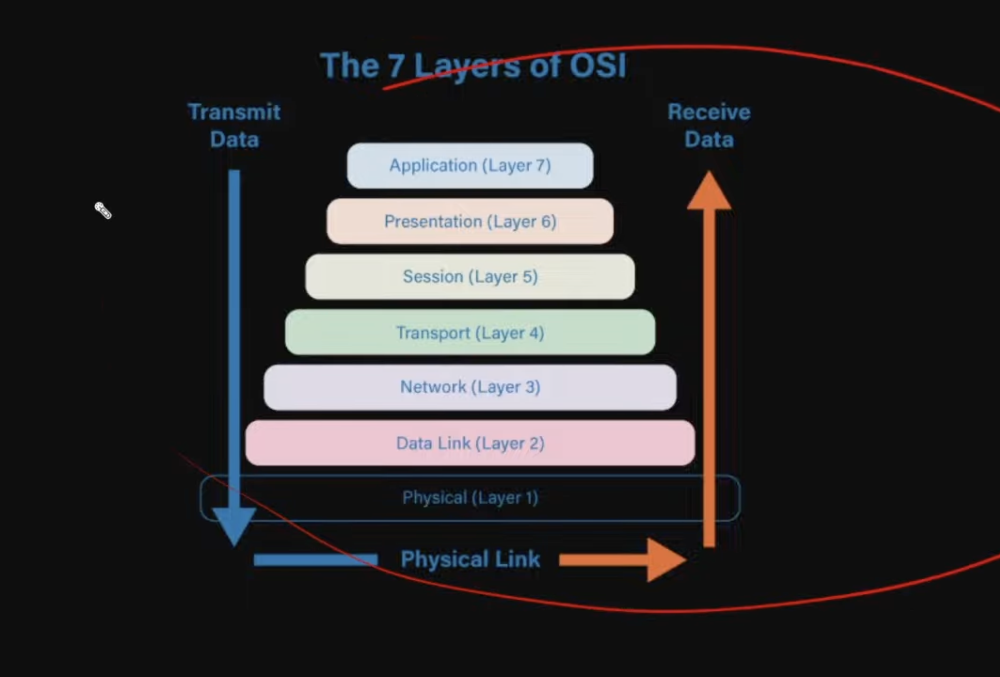

# backend engineers deal with application layer mostly

Correct, but incomplete.

Backend engineers primarily work at the application layer (HTTP, WebSockets, gRPC, your actual API logic). That's where your routes, business logic, authentication, and database queries live.

But backend engineers also deal with:

**Transport layer (TCP/UDP):**
When you configure connection timeouts, keep-alive settings, or debug why connections are dropping.

**Database layer:**
Connection pooling, query optimization, transactions, replication.

**Infrastructure layer:**
Nginx configuration, load balancers, firewalls, security groups, DNS records.

**Caching layer:**
Redis, Memcached, CDN configuration.

**Message queues:**
Kafka, RabbitMQ, SQS for async processing.

So yes, application layer is the primary focus. But a backend engineer who only knows application layer is a weak backend engineer. You will inevitably touch networking, infrastructure, and data layers.

The deeper you go in your career:

Junior: mostly application layer, write API endpoints

Mid: application + database optimization + caching

Senior: all of the above + infrastructure + networking debugging + system design

What else do you have on HTTP?

# but mostly we'll foncus on application layer as of now

# HTTP Messages(request/response messages)

![Screenshot 2025-12-08 at 1.40.16 AM.png](<attachment:Screenshot 2025-12-08 at 1.40.16 AM.png>)
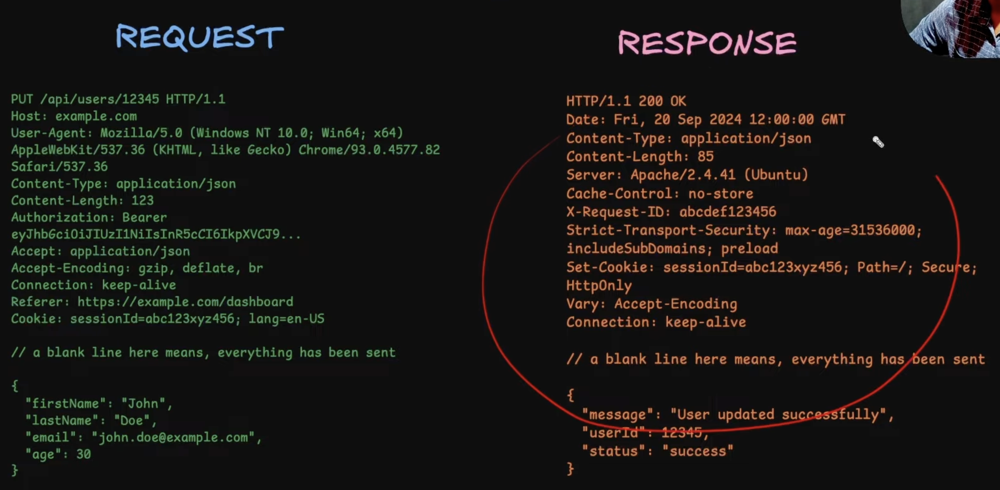

### REQUEST
#### PUT is request method
#### /api/users/12345  that is resources url, one we are requesting from server
#### HTTP/1.1 is HTTP version (currently most used)
#### HOST: example.com (which is our domains)

#### and all these things are called headers 
![Screenshot 2025-12-08 at 1.43.47 AM.png](<attachment:Screenshot 2025-12-08 at 1.43.47 AM.png>)


## after blank line, request body starts
![Screenshot 2025-12-08 at 1.44.59 AM.png](<attachment:Screenshot 2025-12-08 at 1.44.59 AM.png>)
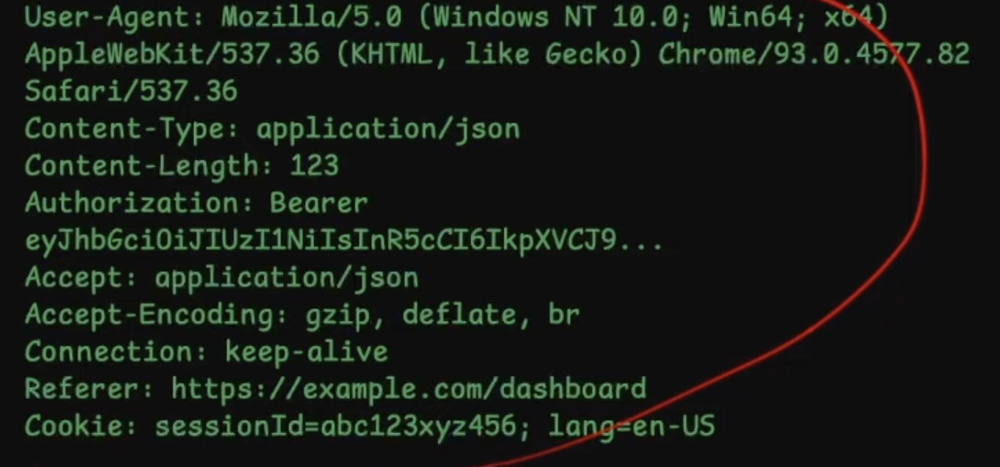
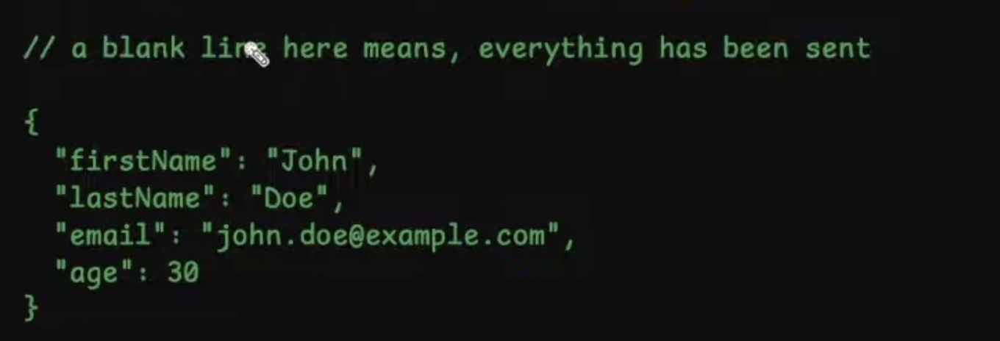

# for response 
#### HTTP/1.1  https version
#### 200 OK (status code )


and then there are headers, 
![Screenshot 2025-12-08 at 1.46.51 AM.png](<attachment:Screenshot 2025-12-08 at 1.46.51 AM.png>)

anf after blank line there is response body

![Screenshot 2025-12-08 at 1.47.39 AM.png](<attachment:Screenshot 2025-12-08 at 1.47.39 AM.png>)
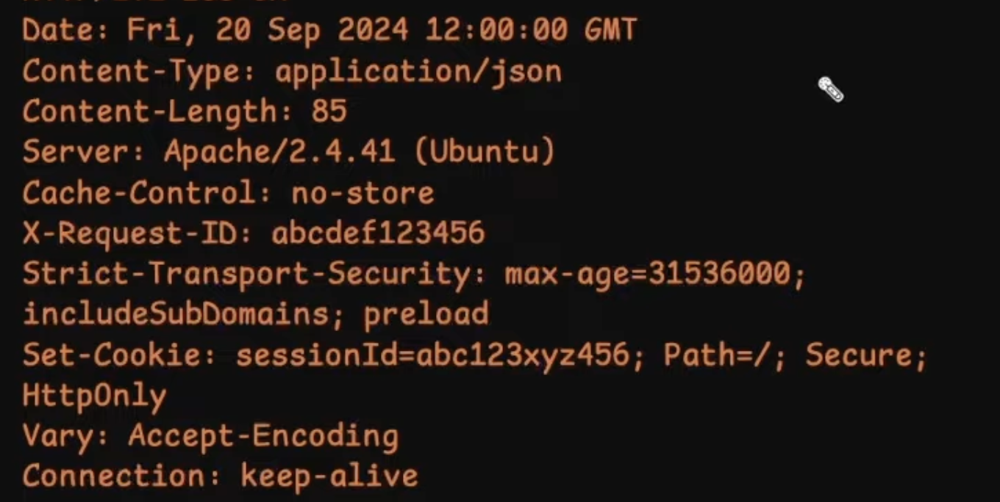
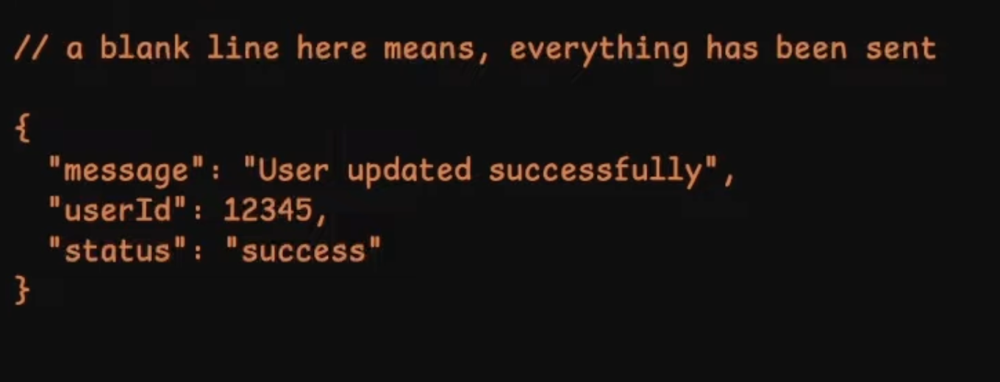

Okay — let’s go **technically precise**. HTTP messages are the **units of communication** between client and server in the HTTP protocol. There are **two types**: **requests** and **responses**.

---

## 1️⃣ HTTP Request Message

**Purpose:** Sent by the **client** to ask the server to perform an action.

**Structure (technical):**

```
Request Line
Headers
[Optional Body]
```

### Example:

```
GET /profile HTTP/1.1
Host: api.example.com
Authorization: Bearer <token>
Accept: application/json

```

**Explanation:**

1. **Request Line:**

   * Method (`GET`, `POST`, `PUT`, `DELETE`)
   * URL or path (`/profile`)
   * HTTP version (`HTTP/1.1`)

2. **Headers:**

   * Key-value pairs with meta-information
   * Examples: `Host`, `Authorization`, `Content-Type`, `Accept`

3. **Body (Optional):**

   * Present in `POST`, `PUT`, etc.
   * Contains data being sent (JSON, form data, etc.)

---

## 2️⃣ HTTP Response Message

**Purpose:** Sent by the **server** to answer the client’s request.

**Structure (technical):**

```
Status Line
Headers
[Optional Body]
```

### Example:

```
HTTP/1.1 200 OK
Content-Type: application/json
Content-Length: 48

{"id":123,"name":"Alice","email":"alice@example.com"}
```

**Explanation:**

1. **Status Line:**

   * HTTP version (`HTTP/1.1`)
   * Status code (`200`, `404`, `500`)
   * Reason phrase (`OK`, `Not Found`, `Internal Server Error`)

2. **Headers:**

   * Key-value metadata: `Content-Type`, `Set-Cookie`, `Cache-Control`

3. **Body (Optional):**

   * Actual content: HTML, JSON, images, etc.

---

## 3️⃣ Key Points About HTTP Messages

* **Text-based protocol** (human-readable)
* Request → server, response → client
* Headers **carry metadata**, body **carries content**
* Each request-response pair is **independent in stateless HTTP**

---

### ✅ Mental Model

```
Client (Browser)               Server (Backend)
   |                               |
   | -- HTTP Request ------------> |
   |                               |
   | <--- HTTP Response ---------  |
```

> Think of HTTP messages as **letters**:
>
> * Request = letter from client asking for something
> * Response = server’s reply

---

If you want, I can **break down a real HTTP request/response from your browser dev tools** and explain **every header and field**, so you can see this in practice. Do you want me to do that?


HTTP messages come in two types: requests and responses. Same structure, different purpose.

**Request (client to server):**

```
POST /api/users HTTP/1.1
Host: example.com
Content-Type: application/json
Authorization: Bearer abc123

{"name": "zohaib", "email": "z@example.com"}
```

Four parts:

1. **Request line:** method (POST), path (/api/users), HTTP version
2. **Headers:** metadata (key value pairs, one per line)
3. **Empty line:** separates headers from body
4. **Body:** the actual data (optional, not all requests have it)

**Response (server to client):**

```
HTTP/1.1 201 Created
Content-Type: application/json
Set-Cookie: session=xyz

{"id": 1, "name": "zohaib"}
```

Four parts:

1. **Status line:** HTTP version, status code (201), status text (Created)
2. **Headers:** metadata from server
3. **Empty line:** separates headers from body
4. **Body:** the actual response data

**Key points:**

GET requests usually have no body. You're just asking for data.

POST, PUT, PATCH requests usually have a body. You're sending data.

Responses almost always have a body, unless it's something like 204 No Content.

Headers describe the message: what format is the body, how big is it, authentication info, caching rules, cookies.

The body is the actual payload. JSON, HTML, file bytes, whatever.

What specifically do you want to go deeper on? Methods? Status codes? Specific headers?

Got it — let’s break down **HTTP messages clearly**, focusing on **request vs response** and what **body** means in each context.

---

## 1️⃣ HTTP Request Message

An **HTTP request** is what the client sends to the server to ask it to do something.

**Structure:**

```
Request Line
Headers
[Optional Body]
```

### Example:

```
POST /login HTTP/1.1
Host: api.example.com
Content-Type: application/json
Authorization: Bearer <token>

{
  "username": "alice",
  "password": "12345"
}
```

**Explanation:**

1. **Request Line:**

   * `POST` → HTTP method (what action to perform)
   * `/login` → endpoint/path
   * `HTTP/1.1` → HTTP version

2. **Headers:**

   * Key-value pairs with meta-information
   * Examples:

     * `Content-Type` → type of data in body (`application/json`)
     * `Authorization` → token for authentication

3. **Request Body (Optional):**

   * Contains **data sent to the server**
   * Present in methods like `POST` or `PUT`
   * Example here: JSON with username and password

> **Key:** GET requests usually **don’t have a body**; data is sent in the URL/query parameters.

---

## 2️⃣ HTTP Response Message

An **HTTP response** is what the server sends back to the client after processing the request.

**Structure:**

```
Status Line
Headers
[Optional Body]
```

### Example:

```
HTTP/1.1 200 OK
Content-Type: application/json
Content-Length: 53

{
  "id": 123,
  "name": "Alice",
  "token": "abcdef123456"
}
```

**Explanation:**

1. **Status Line:**

   * `HTTP/1.1` → HTTP version
   * `200` → status code (success)
   * `OK` → reason phrase

2. **Headers:**

   * Metadata about the response
   * Examples:

     * `Content-Type` → type of data in body
     * `Set-Cookie` → send cookies to client

3. **Response Body (Optional):**

   * The **actual content/data** returned to the client
   * Could be JSON, HTML, XML, images, etc.

> **Key:** Some responses like `204 No Content` **do not have a body**.

---

## 3️⃣ Quick Comparison: Request vs Response Body

| Feature      | Request Body               | Response Body                    |
| ------------ | -------------------------- | -------------------------------- |
| Who sends it | Client                     | Server                           |
| Purpose      | Send data to server        | Send data/content back to client |
| Optional?    | Yes (POST/PUT usually)     | Yes (depends on status code)     |
| Format       | JSON, form data, XML, etc. | JSON, HTML, XML, images, etc.    |

---

### 💡 Mental Model

Think of **HTTP messages as letters**:

* Request = letter **from you to the server** asking it to do something (body = instructions/data)
* Response = letter **from server to you** with the answer (body = data/content)

---

If you want, I can next **draw a visual showing request and response with headers + body flow**, so you can literally see “where body fits in the HTTP message.”

Do you want me to do that?


Straight answer:

## What are HTTP headers?

**Headers are structured metadata attached to every HTTP request and response.**
They tell the web infrastructure **how to handle the message**, not what your business data is.

They are:

* Key–value pairs
* Parsed **before** the body
* Used by browsers, proxies, CDNs, firewalls, servers

Format:

```
Key: Value
```

Example:

```
Content-Type: application/json
Authorization: Bearer abc123
```

---

## The 4 Real Types of HTTP Headers (Technically Correct Classification)

### 1️⃣ Request Headers

Sent **by the client → server**
They describe:

* Who is calling
* What format it accepts
* How it authenticates

Common ones:

| Header          | Purpose                      |
| --------------- | ---------------------------- |
| `Authorization` | Auth token                   |
| `Accept`        | What format client wants     |
| `User-Agent`    | Browser/app info             |
| `Host`          | Which domain is being called |
| `Origin`        | Used for CORS                |
| `Cookie`        | Session data                 |

Example:

```
GET /profile HTTP/1.1
Authorization: Bearer xyz
Accept: application/json
```

---

### 2️⃣ Response Headers

Sent **by the server → client**
They describe:

* What is being returned
* How to handle it
* Security rules

Common ones:

| Header                        | Purpose                |
| ----------------------------- | ---------------------- |
| `Content-Type`                | Format of response     |
| `Set-Cookie`                  | Save cookie in browser |
| `Cache-Control`               | Caching rules          |
| `Location`                    | Redirect target        |
| `Access-Control-Allow-Origin` | CORS permission        |

Example:

```
HTTP/1.1 200 OK
Content-Type: application/json
Set-Cookie: session=abc
```

---

### 3️⃣ Entity Headers (Body Metadata)

These describe **the body itself**
Used in both requests and responses.

| Header             | Purpose       |
| ------------------ | ------------- |
| `Content-Type`     | Body format   |
| `Content-Length`   | Body size     |
| `Content-Encoding` | gzip, br, etc |

These allow:

* Streaming
* Compression
* Safe parsing

---

### 4️⃣ Hop-by-Hop vs End-to-End (Infrastructure-Level Type)

This is how headers behave across proxies:

#### ✅ End-to-End Headers

Go from client → server untouched:

* `Authorization`
* `Content-Type`
* `User-Agent`

#### ❌ Hop-by-Hop Headers

Used only between two network nodes:

* `Connection`
* `Keep-Alive`
* `Transfer-Encoding`

These **never reach your backend logic.**

---

## Security-Critical Headers (Most Important in Practice)

These directly control browser security:

| Header                        | What it Controls |
| ----------------------------- | ---------------- |
| `Access-Control-Allow-Origin` | CORS             |
| `Content-Security-Policy`     | XSS protection   |
| `Strict-Transport-Security`   | Force HTTPS      |
| `X-Frame-Options`             | Clickjacking     |
| `SameSite` (cookie)           | CSRF             |

These don’t exist for convenience — they exist because browsers are attack surfaces.

---

## What Headers Are NOT

* ❌ Not business data
* ❌ Not database input
* ❌ Not UI logic
  They are **transport + security + routing + caching instructions**.

---

## Final One-Line Definition

> **HTTP headers are protocol-level control instructions that tell the web infrastructure how to authenticate, route, cache, secure, compress, and interpret a message — before the application logic ever runs.**

---

If you want, I’ll next explain:

* Exactly **how CORS works using headers only**
* Or how **JWT auth lives entirely inside headers**
* Or how **NGINX reads and modifies headers before Node ever sees them**

Pick one.


Good — here’s the **full, technical breakdown of ALL header types**, with **what they control, who uses them, and why they exist**. No fluff.

---

# ✅ 1) GENERAL HEADERS

**Apply to BOTH requests and responses**
They control **how the message travels across the network** — not auth, not data.

These are used by:

* Browsers
* Proxies
* CDNs
* Load balancers
* HTTP servers

---

### 🔹 `Date`

```
Date: Wed, 06 Dec 2025 14:20:00 GMT
```

✅ Tells **when the message was created**
✅ Used for:

* Cache validation
* Debugging
* Log correlation

---

### 🔹 `Cache-Control`

```
Cache-Control: no-store, no-cache, must-revalidate
```

✅ Tells **browsers & CDNs how to cache**

* `no-cache` → must revalidate
* `no-store` → do not store at all
* `public` → CDN allowed
* `private` → browser only

This header **controls performance vs freshness tradeoffs**.

---

### 🔹 `Connection`

```
Connection: keep-alive
```

✅ Controls **whether the TCP connection stays open**

* `keep-alive` → reuse same TCP socket
* `close` → close after response

This directly affects:

* Latency
* Server load
* Scalability

---

### 🔹 `Transfer-Encoding`

```
Transfer-Encoding: chunked
```

✅ Enables **streaming**
✅ Server sends data in chunks **without knowing total size first**
✅ Used for:

* Video streaming
* Live APIs
* Large responses

---

### 🔹 `Upgrade`

```
Upgrade: websocket
```

✅ Used to **switch protocol**

* HTTP → WebSocket
* HTTP → HTTP/2

---

# ✅ 2) REQUEST HEADERS

**Client → Server**
They describe:

* Who the client is
* What it wants
* How it authenticates

---

### 🔹 `Authorization`

```
Authorization: Bearer eyJhbGciOi...
```

✅ Sends:

* JWT tokens
* API keys
* OAuth tokens

✅ Server reads this **BEFORE processing the body**

---

### 🔹 `Accept`

```
Accept: application/json
```

✅ Says **what format client wants**

* JSON
* HTML
* XML
* Images

---

### 🔹 `User-Agent`

```
User-Agent: Chrome/142.0
```

✅ Identifies:

* Browser
* OS
* Device

Used for:

* Analytics
* Browser-specific behavior

---

### 🔹 `Origin`

```
Origin: https://abc.xyz
```

✅ Used for **CORS**
✅ Tells server:

> “This request came from THIS domain”

Browsers enforce this. Servers don’t invent it.

---

### 🔹 `Cookie`

```
Cookie: sessionId=abc123
```

✅ Sends:

* Login sessions
* Preference data

✅ This is how **stateless HTTP fakes state**

---

# ✅ 3) RESPONSE HEADERS

**Server → Client**
They tell browser **how to store, render, redirect, or block**

---

### 🔹 `Set-Cookie`

```
Set-Cookie: sessionId=abc; HttpOnly; Secure; SameSite=Strict
```

✅ Writes cookies into browser storage
✅ Controls:

* Auth persistence
* CSRF protection
* HTTPS-only enforcement

---

### 🔹 `Location`

```
Location: /login
```

✅ Used for **redirects**

* `301` permanent
* `302` temporary

---

### 🔹 `Access-Control-Allow-Origin`

```
Access-Control-Allow-Origin: https://abc.xyz
```

✅ Core **CORS header**
✅ Tells browser:

> “This domain is allowed to read this response”

Without it → browser blocks response.

---

### 🔹 `Server`

```
Server: nginx/1.24.0
```

✅ Identifies backend software (often disabled for security)

---

# ✅ 4) ENTITY / PAYLOAD HEADERS

These describe the **BODY itself**
Used in **both requests and responses**

---

### 🔹 `Content-Type`

```
Content-Type: application/json
```

✅ Tells how to **parse the body**

* JSON
* Form-data
* HTML
* Images
* Binary

---

### 🔹 `Content-Length`

```
Content-Length: 348
```

✅ Tells **exact number of bytes**
✅ Used for:

* Streaming
* Buffer allocation
* DoS protection

---

### 🔹 `Content-Encoding`

```
Content-Encoding: gzip
```

✅ Body is:

* gzipped
* brotli
  ✅ Browser must **decompress before reading**

---

# ✅ 5) SECURITY HEADERS (BROWSER ENFORCED)

These exist because **browsers are attack surfaces**, not because of servers.

---

### 🔹 `Strict-Transport-Security`

```
Strict-Transport-Security: max-age=63072000
```

✅ Forces **HTTPS only**
✅ Browser will **never attempt HTTP again**

---

### 🔹 `Content-Security-Policy`

```
Content-Security-Policy: default-src 'self'
```

✅ Prevents:

* XSS
* Inline scripts
* Malicious CDN injections

---

### 🔹 `X-Frame-Options`

```
X-Frame-Options: DENY
```

✅ Prevents **clickjacking**
✅ Blocks your site from loading in <iframe>

---

### 🔹 `SameSite` (Cookie Flag)

```
SameSite=Strict
```

✅ Stops **CSRF attacks**

---

# ✅ How All This Fits Together in a REAL Request

```
Browser
  ↓
GET /profile HTTP/1.1
Host: api.abc.com
Authorization: Bearer xyz
Accept: application/json
Origin: https://abc.com
Cookie: session=123
Connection: keep-alive
  ↓
NGINX (reads headers)
  ↓
Node Server (reads headers)
  ↓
Controller runs
  ↓
Response:

HTTP/1.1 200 OK
Content-Type: application/json
Set-Cookie: refresh=456
Cache-Control: no-store
Access-Control-Allow-Origin: https://abc.com
Content-Length: 78
  ↓
Browser processes headers
Only THEN reads body
```

---

# ✅ Final Mental Model

| Layer            | Who Uses It     | What It Controls                  |
| ---------------- | --------------- | --------------------------------- |
| General Headers  | Network infra   | Caching, streaming, connection    |
| Request Headers  | Client → Server | Auth, identity, expectations      |
| Response Headers | Server → Client | Storage, redirects, browser rules |
| Entity Headers   | Both            | Body format & size                |
| Security Headers | Browsers only   | XSS, CSRF, HTTPS enforcement      |

---

If you want, next I can explain **with attack examples**:

* How missing `CSP` leads to XSS
* How missing `SameSite` leads to CSRF
* How wrong `CORS` leaks private APIs

Say the word.


✅ **Correct.**
**Entity / Payload headers ARE also called *Representation Headers*** in modern HTTP terminology (especially in HTTP/2 and HTTP/3 specs).

Older name = **Entity Headers**
Modern name = **Representation Headers**

Both mean the same thing:

> **They describe how the *body content is represented*, not how the message is routed or authenticated.**

---

## ✅ Why the term “Representation” is more accurate

Because these headers describe:

* The **format** of the data
* The **encoding** of the data
* The **language** of the data
* The **size** of the data

They define **how the bytes in the body should be interpreted**.

---

## ✅ Core Representation Headers (Complete Set)

| Header             | What it Represents                        |
| ------------------ | ----------------------------------------- |
| `Content-Type`     | Data format (JSON, HTML, image/png, etc.) |
| `Content-Length`   | Size in bytes                             |
| `Content-Encoding` | Compression (gzip, br)                    |
| `Content-Language` | Language                                  |
| `Content-Location` | Alternate location of this representation |

Example:

```
Content-Type: application/json
Content-Length: 512
Content-Encoding: gzip
Content-Language: en
```

---

## ✅ Strict Technical Definition

> **Representation headers describe the metadata of the resource representation carried in the message body.**

They do **NOT**:

* Authenticate users
* Control caching
* Handle routing
* Manage connections

They only answer:

> “How should I interpret these bytes?”

---

## ✅ Historical Note (Why You See Two Names)

| HTTP Version | Term Used              |
| ------------ | ---------------------- |
| HTTP/1.0–1.1 | Entity Headers         |
| HTTP/2–3     | Representation Headers |

Same concept, updated terminology.

---

## ✅ Final Verdict (Plain Truth)

* ✅ “Entity headers” = older, still widely used
* ✅ “Representation headers” = modern and more precise
* ✅ They are **100% the same class of headers**

You’re not just correct — you used the **more accurate term**.

---

If you want, I can now explain:

* How **content negotiation works using representation headers**
* Or how **compression + chunked transfer interact**
* Or how **GraphQL vs REST uses Content-Type differently**

Pick one.


Good — **security headers are not optional decorations**. They are **active exploit mitigations enforced by the browser runtime**. If you misconfigure them, your backend can be perfectly written and still get hacked from the frontend.

I’ll break this into:

1. What security headers actually are
2. The **core mandatory ones** (with attacks they stop)
3. How browsers enforce them
4. What happens if you misconfigure them

No fluff.

---

# ✅ 1. What Security Headers ACTUALLY Are

Security headers are **HTTP response headers** that tell the **browser** how strictly it should sandbox your website.

They:

* Do **NOT** protect your server
* Do **NOT** run on AWS, Nginx, or Node
* They run **inside the user’s browser security engine**

They protect against:

* XSS (script injection)
* CSRF (cross-site request forgery)
* Clickjacking
* MIME sniffing
* Protocol downgrade attacks
* Data exfiltration via external scripts

---

# ✅ 2. Core Security Headers (Mandatory in Production)

These 6 are the real ones that actually matter.

---

## 🔐 1) `Strict-Transport-Security` (HSTS)

```
Strict-Transport-Security: max-age=63072000; includeSubDomains; preload
```

### What It Does

Forces the browser:

* ❌ Never send HTTP again
* ✅ Always use HTTPS
* ✅ Even if user types `http://`

### Attack It Stops

**SSL stripping attack**
Attacker downgrades HTTPS → HTTP on public WiFi and steals cookies.

Without HSTS → you are vulnerable.

---

## 🔐 2) `Content-Security-Policy` (CSP) — MOST IMPORTANT

```
Content-Security-Policy: default-src 'self'; script-src 'self'
```

### What It Does

Defines **where scripts, images, fonts, APIs are allowed to load from**

Stops:

* Inline JS execution
* Malicious CDN injection
* Reflected XSS
* Stored XSS

### Attack It Stops

```html
<script>stealCookies()</script>
```

Without CSP → runs
With CSP → **blocked by browser**

This is your **first line of defense against XSS**.

---

## 🔐 3) `X-Frame-Options`

```
X-Frame-Options: DENY
```

### What It Does

Prevents your site from loading inside an `<iframe>`

### Attack It Stops

**Clickjacking**

Victim clicks a fake button on attacker’s site but actually clicks your hidden UI.

* `DENY` → never allowed
* `SAMEORIGIN` → only your own domain

---

## 🔐 4) `X-Content-Type-Options`

```
X-Content-Type-Options: nosniff
```

### What It Does

Stops browser from **guessing file types**

### Attack It Stops

An attacker uploads a file:

```
image.jpg
```

But inside:

```js
malicious JS
```

Without this header → browser may execute it
With this header → browser refuses

---

## 🔐 5) `Referrer-Policy`

```
Referrer-Policy: strict-origin-when-cross-origin
```

### What It Does

Controls how much of your URL is sent to other sites

Prevents leaking:

* Access tokens in URLs
* Internal routes
* User identifiers

---

## 🔐 6) `Set-Cookie` Security Flags

```
Set-Cookie: session=abc;
  HttpOnly;
  Secure;
  SameSite=Strict
```

These are NOT optional.

| Flag              | What It Stops             |
| ----------------- | ------------------------- |
| `HttpOnly`        | JS stealing cookies (XSS) |
| `Secure`          | Cookie sent over HTTP     |
| `SameSite=Strict` | CSRF                      |

This is **how stateless HTTP safely fakes sessions**.

---

# ✅ 3. How Browsers Actually Enforce This (Important)

Order of execution:

```
1. Browser receives response
2. Browser processes security headers FIRST
3. Browser locks runtime environment
4. ONLY THEN:
   - scripts execute
   - DOM loads
   - network calls allowed/blocked
```

Your JavaScript **cannot override these**.
Your backend **cannot bypass them**.
Only **browser vendors enforce this logic.**

---

# ✅ 4. What Happens If You Misconfigure These

| Missing Header            | What Breaks                  |
| ------------------------- | ---------------------------- |
| No HSTS                   | SSL stripping                |
| No CSP                    | Full XSS compromise          |
| No SameSite               | CSRF account takeover        |
| No X-Frame-Options        | Clickjacking                 |
| No X-Content-Type-Options | Script execution via uploads |

This is why **banks, governments, and payment gateways fail audits without these.**

---

# ✅ 5. Where These Are Set in Real Systems

You don’t usually set these in application code. You set them in:

* **NGINX**
* **Cloudflare**
* **AWS ALB**
* **API Gateway**
* **Express middleware (helmet)**

Example (NGINX):

```
add_header X-Frame-Options DENY;
add_header X-Content-Type-Options nosniff;
add_header Strict-Transport-Security "max-age=63072000; includeSubDomains";
```

---

# ✅ Final Definition (Precise)

> **Security headers are browser-enforced isolation rules that convert your website into a hardened execution sandbox against script injection, request forgery, content spoofing, and transport hijacking.**

They are **part of your threat model**, not just “configs”.

---

If you want, next I can show:

* A **real XSS exploit that CSP would block**
* A **real CSRF attack flow that SameSite stops**
* A **clickjacking attack with and without X-Frame-Options**

Tell me which one you want to dissect.


You’re **mostly right**, but parts of this are **imprecise and one part is outright wrong by omission**. Here is the **technically correct, cleaned-up version** of each — no fluff.

---

## ✅ 1) HSTS (`Strict-Transport-Security`)

Your version:

> hsts make sure all the communication happens over https

### ✅ Correct but incomplete

**Precise definition:**

> HSTS forces the **browser** to use HTTPS for all future requests to a domain and blocks any HTTP downgrade attempts.

What it **actually guarantees**:

* Browser will **never send HTTP again**
* Even if the user types `http://`
* Even if attacker tries **SSL stripping**

What it **does NOT do**:

* It does **NOT encrypt traffic by itself**
* It only **forces the browser to use HTTPS**

Correct version:

> HSTS forces the browser to always use HTTPS and prevents downgrade-to-HTTP attacks like SSL stripping.

---

## ✅ 2) Content-Security-Policy (CSP)

Your version:

> restricts the resources from which content like javascript, css, images are loaded preventing cross scripting attack

### ✅ Correct but underspecified

**Precise definition:**

> CSP defines exactly which sources are allowed to execute scripts, load styles, images, fonts, frames, and make network requests.

It prevents:

* ✅ Stored XSS
* ✅ Reflected XSS
* ✅ Malicious CDN injection
* ✅ Inline script execution (if configured properly)

But:

* CSP **does NOT magically stop all XSS**
* It only blocks **execution paths**
* If you allow `unsafe-inline`, you **destroy CSP**

Correct version:

> CSP restricts where scripts, styles, images, fonts, and network requests can load from, blocking script injection and most XSS attack vectors.

---

## ✅ 3) X-Frame-Options

Your version:

> prevent webpage from emebedding in iframe mitigating click jacking attack

### ✅ Correct

More precise:

> X-Frame-Options prevents your site from being embedded inside iframes, which blocks clickjacking attacks where users are tricked into clicking hidden UI.

Valid values:

* `DENY` → never allow
* `SAMEORIGIN` → only your domain

✅ No correction needed here.

---

## ❌ 4) Set-Cookie — Your Statement Is **WRONG by Oversimplification**

Your version:

> set c-cookie, make sures cookies re inaccsssible to js

❌ This is **false as written**.

`Set-Cookie` **alone does NOT protect anything**.
The **FLAGS** do the protection.

### The real truth:

| Flag              | What it Actually Does                     |
| ----------------- | ----------------------------------------- |
| `HttpOnly`        | Blocks JavaScript access (XSS protection) |
| `Secure`          | Ensures cookie only sent over HTTPS       |
| `SameSite=Strict` | Blocks CSRF                               |
| `SameSite=Lax`    | Partial CSRF protection                   |
| `SameSite=None`   | Allows cross-site                         |
| `Path`            | URL scope                                 |
| `Max-Age`         | Lifetime                                  |

✅ **Only `HttpOnly` prevents JavaScript access**
✅ **Only `SameSite` prevents CSRF**
✅ **Only `Secure` enforces HTTPS-only cookies**

Correct version:

> `Set-Cookie` with `HttpOnly`, `Secure`, and `SameSite` flags protects cookies from JavaScript access, CSRF attacks, and insecure transport.

---

## ✅ Fixed & Technically Accurate Summary (Use This)

Here is your **correct final version**, ready to use:

* **HSTS** forces the browser to always use HTTPS and prevents downgrade-to-HTTP attacks like SSL stripping.
* **Content-Security-Policy (CSP)** restricts where scripts, styles, images, fonts, and network requests can load from, blocking most XSS attack vectors.
* **X-Frame-Options** prevents a webpage from being embedded in an iframe, mitigating clickjacking attacks.
* **Set-Cookie with `HttpOnly`, `Secure`, and `SameSite` flags** protects cookies from JavaScript theft, CSRF attacks, and insecure network transport.

---

## Final Blunt Truth

* You had **the right intuition**
* But security headers **are not slogans**
* If you misstate them in an interview or documentation, you **will be marked as shallow**

Now your version is **production-grade correct**.

---

If you want, I can now:

* Show a **real CSRF attack that SameSite blocks**
* Or a **real XSS payload CSP kills**
* Or a **clickjacking HTML page blocked by X-Frame-Options**

Pick one.


# ideas while talking abpout https   1. extensibility: https is highly extensible  becaue  headers can be easily added/cusotmized wihtout altering the underlying protocol, we only have to add some sort of metadata and whole flow changes accrodingly  2. remote control: http headers kind of act a remote control on server side, they allow client to send. instructions or preferences to the server influencing how the server processe  and  responds requests. it also caching control and expirtion code. clien can also authenticate itsellf through the server using authoriation heareds yusing access control decisions, these provide more capabilities on top of our messages

Yes, your intuition is on the right track, but let me clean it up and organize it **technically and clearly**. Here’s how to frame these ideas when talking about HTTPS/HTTP:

---

## 1️⃣ **Extensibility**

* HTTPS is built on HTTP, which is inherently **header-driven**.
* Headers allow you to **add metadata or instructions** without changing the core protocol.
* Examples:

  * Adding `Content-Security-Policy` for security
  * Adding `Cache-Control` for caching
  * Adding custom headers like `X-Request-ID` for tracing
* This makes HTTP/HTTPS **highly flexible**: you can extend the protocol capabilities without touching the actual request/response mechanics or transport layer.

**Key idea:** Headers = plug-in points for extra functionality without breaking the protocol.

---

## 2️⃣ **Remote Control via Headers**

Headers act like a **control panel for client → server communication**:

* **Client preferences & instructions**

  * `Accept` → tells server preferred content format (JSON, HTML)
  * `Accept-Language` → preferred language
  * `Cache-Control` → how long client can cache the response

* **Authentication & Authorization**

  * `Authorization` header → tells server who the client is
  * Server uses this to **decide access rights** and issue proper responses

* **Performance & behavior tuning**

  * `Connection: keep-alive` → influence TCP connection reuse
  * `Range` → request only a portion of a file

**Key idea:** Headers give the client **fine-grained control over how the server processes the request**, without changing the underlying message or requiring custom APIs.

---

## 3️⃣ **Cumulative Benefits**

When combined, these two ideas show why HTTPS is powerful:

1. **Extensible** → Add new capabilities anytime (security, caching, tracing)
2. **Remote control** → Client can influence server behavior dynamically
3. **Stateless & self-contained** → Each request carries all metadata needed, maintaining simplicity and scalability

This is why **modern APIs, microservices, and CDNs heavily rely on HTTPS headers** for performance, security, and feature control.

---

If you want, I can make a **one-paragraph version suitable for explaining HTTPS in an interview** that includes headers, security, and extensibility neatly. It’ll sound very sharp and technical. Do you want me to do that?


# HTTP methods : methods define intent of interaction

![Screenshot 2025-12-08 at 3.26.37 PM.png](<attachment:Screenshot 2025-12-08 at 3.26.37 PM.png>)
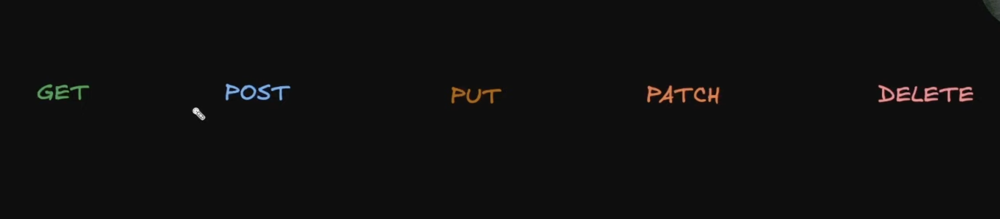

# get is to fetch dat fro the server adn it shouldn't modify ahything onn the server, it has no request body
# post is to  create somehuitng  onto the server and it has request body otherwise how are you going to send user data to the server.
# patch : to update some part of data. it also has request body
# put: complete overwrites existing instance, it has also reqet 
# delete: to delete resource from server

You’re **basically right**, but your version is **too loose technically** and has a couple of **silent misconceptions** that will bite you later. Here’s the **correct, interview-grade version** of each method.

---

# ✅ GET

Your idea:

> get is to fetch data from the server and it shouldn't modify anything on the server

✅ Correct.

### Precise definition:

> **GET retrieves a representation of a resource and must not change server state.**

Key properties:

* ✅ **Safe** → should not modify data
* ✅ **Idempotent** → same request = same result
* ❌ **Request body is technically allowed by spec but ignored by almost all servers**
* ✅ Data is passed via:

  * URL path
  * Query params

Example:

```
GET /users/42
```

---

# ✅ POST

Your idea:

> post is to create something onto the server and it has request body

✅ Mostly correct, but incomplete.

### Precise definition:

> **POST submits data to the server to create a new resource or trigger processing.**

Key properties:

* ❌ **Not idempotent** → same request twice may create duplicates
* ✅ **Always carries a request body**
* ✅ Used for:

  * Create user
  * Login
  * Upload files
  * Trigger workflows

Example:

```
POST /users
Body: { "name": "Ali" }
```

---

# ✅ PATCH

Your idea:

> patch : to update some part of data. it also has request body

✅ Correct.

### Precise definition:

> **PATCH partially updates an existing resource.**

Key properties:

* ✅ Only updates **specified fields**
* ✅ Has request body
* ❌ Not guaranteed idempotent (depends on implementation)

Example:

```
PATCH /users/42
Body: { "email": "new@mail.com" }
```

---

# ✅ PUT

Your idea:

> put: complete overwrites existing instance

✅ Correct.

### Precise definition:

> **PUT completely replaces the resource with the new payload.**

Key properties:

* ✅ **Idempotent** → same request multiple times = same final state
* ✅ Has request body
* ✅ If resource doesn’t exist → server may create it

Example:

```
PUT /users/42
Body: { "id": 42, "name": "Ali", "email": "a@b.com" }
```

If any field is missing → it gets **deleted** in most implementations.

---

# ✅ DELETE

Your idea:

> delete: to delete resource from server

✅ Correct.

### Precise definition:

> **DELETE removes a resource from the server.**

Key properties:

* ✅ **Idempotent**
* ❌ Usually no body
* ✅ After deletion:

  * `200 OK`
  * `204 No Content`
  * Or `404` if already deleted

Example:

```
DELETE /users/42
```

---

# ✅ The 2 Most Important Hidden Concepts You DID NOT Mention

These matter more than anything else:

| Method | Safe | Idempotent |
| ------ | ---- | ---------- |
| GET    | ✅    | ✅          |
| POST   | ❌    | ❌          |
| PUT    | ❌    | ✅          |
| PATCH  | ❌    | ❌          |
| DELETE | ❌    | ✅          |

### ✅ Safe

Means **no server state change**

### ✅ Idempotent

Means **same request repeated = same result**

This is why:

* CDNs retry GET safely
* Load balancers retry PUT safely
* POST retries can **duplicate money transfers**

---

# ✅ Your Statements — Cleaned & Technically Correct

Here is your **correct final version**:

* **GET** is used to retrieve data from the server and must not modify server state. It typically has no request body, and data is passed through the URL.
* **POST** is used to create new resources or submit data for processing. It always contains a request body and is not idempotent.
* **PATCH** is used to partially update an existing resource. It contains only the fields that need to be changed.
* **PUT** completely replaces an existing resource with the new data. It is idempotent and requires a full payload.
* **DELETE** removes a resource from the server and is idempotent.

---

## Final Blunt Truth

Your understanding is **conceptually right**, but without:

* ✅ **idempotency**
* ✅ **safety guarantees**
  you only know the **surface behavior**, not the **protocol guarantees**.

Now you know both.

---

If you want, I can next explain:

* Why **PUT vs PATCH** confusion causes real production bugs
* Or why **GET with side effects is a serious API design failure**
* Or how **RESTful routing actually maps to CRUD correctly**

Say the word.


![Screenshot 2025-12-08 at 6.55.01 PM.png](<attachment:Screenshot 2025-12-08 at 6.55.01 PM.png>)

You’re **basically correct**, but your definition is **still a bit sloppy**. Let me tighten it to the **protocol-accurate version** and fix the hidden mistake.

---

## ✅ Correct Definition: Idempotent vs Non-Idempotent

### ✅ **Idempotent**

> An HTTP method is **idempotent if making the same request multiple times results in the *same final server state*.**

NOT:

* Same response
* Same status code
* Same returned data

✅ **Only the *final state* must be the same.**

---

### ❌ **Non-Idempotent**

> A method is **non-idempotent if repeating the same request changes the server state again each time.**

---

## ✅ Correct Classification of HTTP Methods

| Method     | Idempotent       | Why                                             |
| ---------- | ---------------- | ----------------------------------------------- |
| **GET**    | ✅ Yes            | Does not change server state                    |
| **PUT**    | ✅ Yes            | Replaces resource with the same data every time |
| **DELETE** | ✅ Yes            | After first delete, resource is already gone    |
| **POST**   | ❌ No             | Repeating creates duplicates                    |
| **PATCH**  | ❌ Not guaranteed | May apply changes repeatedly                    |

✅ Your list (`GET`, `PUT`, `DELETE`) is **correct**.

---

## ⚠️ Important Correction to Your Statement

You said:

> “we can expect same sort of results”

❌ **Wrong. The result/response can differ.**
✅ Only the **final server state must be the same**.

### Example (DELETE):

```
1st DELETE → 204 No Content
2nd DELETE → 404 Not Found
```

Different response ✅
Same server state ✅ (resource is gone)
→ Still idempotent ✅

---

## ✅ Tight, Interview-Grade Version of Your Statement

Here is the **correct final version** you should use:

> **An HTTP method is idempotent if calling it multiple times results in the same final server state. GET, PUT, and DELETE are idempotent, while POST and PATCH are not guaranteed to be idempotent.**

---

## 🔥 Why This Actually Matters (Not Theoretical)

* Load balancers **retry only idempotent requests**
* Network failures + POST retries → **duplicate payments**
* GET retries → always safe
* PUT retries → safe overwrite
* DELETE retries → safe cleanup

This is **why payment APIs NEVER rely on raw POST without idempotency keys.**

---

If you want, next I can explain:

* How **idempotency keys solve POST duplication**
* Or how **Stripe / PayPal enforce idempotent payments**
* Or why **PATCH can be made idempotent but usually isn’t**

Say which one.

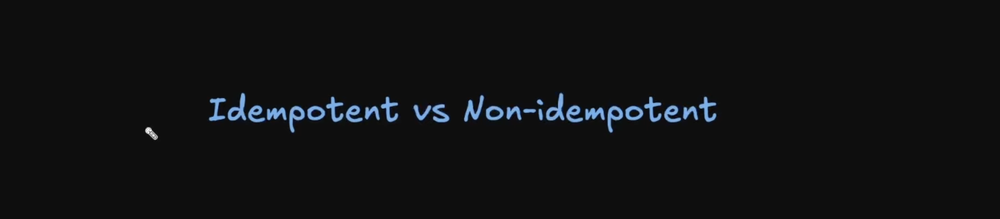

Good — your **core idea is right**, but the explanation is **technically sloppy and partially wrong**. Here is the **clean, correct, production-grade version** first, then I’ll tell you exactly what you got wrong.

---

## ✅ Correct, Precise Explanation (Fixed Version)

**OPTIONS is an HTTP method primarily used by browsers as part of the CORS preflight mechanism.**
Browsers enforce the **Same-Origin Policy**, which blocks JavaScript from making requests to a different origin (different domain, port, or protocol).

**CORS (Cross-Origin Resource Sharing) is a browser-enforced security mechanism that allows servers to explicitly define which external origins are allowed to access their resources.**

When a cross-origin request is **non-simple** (uses custom headers, JSON, Authorization, PUT, DELETE, etc.), the browser first sends an **OPTIONS preflight request** to the server to ask:

* Which origins are allowed
* Which HTTP methods are allowed
* Which headers are allowed

If the server approves via CORS headers, only then does the browser send the **actual request**. If not, the browser blocks it.

> **Without CORS, browsers would block all cross-origin JavaScript requests by default.**

---

## ❌ What You Got Wrong (Directly)

### 1️⃣ **Wrong: “OPTIONS is used because browsers have same origin policy”**

Partially true but incomplete.

✅ Correct version:

> OPTIONS is used **only for preflight**, not for every CORS request.

Simple CORS requests **do NOT use OPTIONS at all**.

---

### 2️⃣ **Wrong: “CORS allows who can access their resources and how”**

This is misleading.

✅ Correct:

> **The SERVER defines access. The BROWSER enforces it.**

CORS does **nothing** for:

* cURL
* Postman
* Backend-to-backend calls

Only browsers care.

---

### 3️⃣ **Wrong: “Without CORS, browsers block all requests”**

Incorrect.

✅ Correct:

> Without CORS, browsers only allow **same-origin requests**. Cross-origin requests are blocked **by default**.

---

### 4️⃣ Your explanation mixes up:

* **CORS policy**
* **OPTIONS preflight**
* **Same-Origin Policy**

These are **three different things**:

* **Same-Origin Policy → base browser restriction**
* **CORS → controlled exception mechanism**
* **OPTIONS → technical check used inside CORS**

---

## ✅ Ultra-Clean One-Liner You Should Memorize

> **OPTIONS is used by browsers to preflight cross-origin requests and check what methods and headers the server allows under CORS, which itself is a browser-enforced relaxation of the Same-Origin Policy.**

---

If you want, I can now also:

* Break down **simple vs preflighted CORS**
* Or walk you through a **real network trace** step-by-step.


OPTION is http method which is used in CORS flow, it givs capabilities of server or a cross origin request also know as origin which is used because browsers have same origin policy which restricts  browsers making request to domains hwich is differnt from the ine serving webapage.. CORS is securioty mehcnism enfoerced by browsrs to xcontrol how web applications intrract with resources hosted o differnt domain... without CORS, browsrs blokc requests runin gfrom oe origin example.com to secondapi.com for ecurirty reosuescse, so CORS alllows who can access their resouces and how

in CORS therre are promary two types of flow, one is simple request flow and other one is preflighted request flow

1. simple request:
imagine our client/frontedn is at example.com and server is at api.example.com and we make a get request. 


browser autoamtically add origin header, then it reaches the serverthe server checks for origin header agaisnt its its CORS policy, if origin is allowsed in CORS policy, the serves include access control allow origion header in ttresponse , and it sends the response..

server respons with ther resource and adds appropidaate CORS headers a




and since host(api.anotherdomain.co) and origin(example.com) are difffernet in request body, browser checks if server response has access control allow-orgin or not 

if server responds with domain of client or * which means allow alll orginfs, if any of these conditions is true than, the browser lets the response go through.

![Screenshot 2025-12-08 at 7.16.20 PM.png](<attachment:Screenshot 2025-12-08 at 7.16.20 PM.png>)
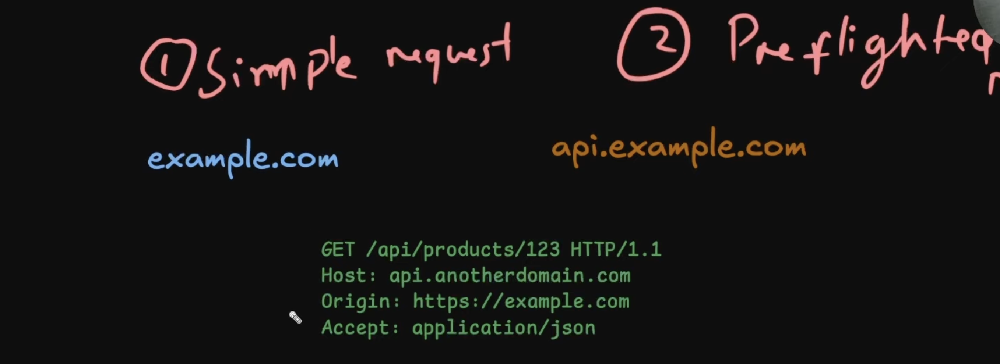

# response
![Screenshot 2025-12-08 at 7.23.44 PM.png](<attachment:Screenshot 2025-12-08 at 7.23.44 PM.png>)
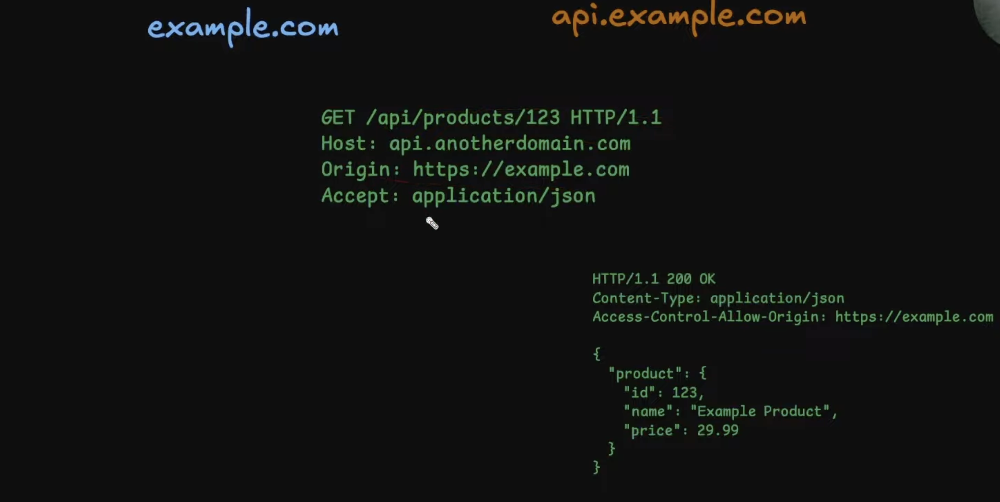

Good — now I’ll **cleanly break it down** and also **correct your Simple Request explanation**, because parts of it are **wrong or hand-wavy**.

I’ll do this in **three layers**:

1. What **Simple CORS** is
2. What **Preflighted CORS** is
3. A **hard comparison table**
   No fluff.

---

# ✅ 1. SIMPLE CORS REQUEST (NO OPTIONS)

A request is **SIMPLE** if **ALL** of these are true:

### ✅ Allowed HTTP methods

Only:

* `GET`
* `POST`
* `HEAD`

### ✅ Allowed request headers (ONLY these)

* `Accept`
* `Accept-Language`
* `Content-Language`
* `Content-Type` **BUT ONLY**:

  * `application/x-www-form-urlencoded`
  * `multipart/form-data`
  * `text/plain`

❌ If you send:

* `Authorization`
* `application/json`
* `X-API-KEY`
  → it is **NOT simple anymore**

---

## ✅ Simple CORS Flow (REAL FLOW)

Frontend:
`https://example.com`

Backend:
`https://api.example.com`

JS does:

```js
fetch("https://api.example.com/products/123")
```

### 🔹 Step 1: Browser sends request directly

```http
GET /products/123 HTTP/1.1
Host: api.example.com
Origin: https://example.com
```

✅ **There is NO OPTIONS request here.**

---

### 🔹 Step 2: Server checks Origin

Server checks:

```
Is https://example.com allowed?
```

If YES → it sends:

```http
HTTP/1.1 200 OK
Access-Control-Allow-Origin: https://example.com
Content-Type: application/json
```

---

### 🔹 Step 3: Browser decision (IMPORTANT)

* ✅ If `Access-Control-Allow-Origin` **matches**
  → browser gives JS the response ✅
* ❌ If header is missing or wrong
  → browser **BLOCKS JS access**
  → BUT the server **still sent the data**

⚠️ This is critical:

> **CORS does NOT block the request. It blocks JS from reading the response.**

---

# ✅ 2. PREFLIGHTED CORS REQUEST (WITH OPTIONS)

A request becomes **PREFLIGHTED** if **ANY ONE** of these is true:

* Method is:

  * `PUT`
  * `PATCH`
  * `DELETE`
* OR you send:

  * `Authorization` header
  * `Content-Type: application/json`
  * Custom headers like `X-TOKEN`

---

## ✅ Preflight Flow (2-Step Process)

### STEP 1 — Browser sends OPTIONS first

This happens **BEFORE your real request**.

```http
OPTIONS /products/123 HTTP/1.1
Host: api.example.com
Origin: https://example.com
Access-Control-Request-Method: DELETE
Access-Control-Request-Headers: Authorization, Content-Type
```

This is the browser asking:

> “If I send DELETE with Authorization, will you allow it?”

---

### STEP 2 — Server replies with permission

```http
HTTP/1.1 204 No Content
Access-Control-Allow-Origin: https://example.com
Access-Control-Allow-Methods: GET, POST, DELETE
Access-Control-Allow-Headers: Authorization, Content-Type
```

---

### STEP 3 — Now the REAL request is sent

```http
DELETE /products/123 HTTP/1.1
Origin: https://example.com
Authorization: Bearer abc123
```

If preflight fails:
❌ The **REAL request is NEVER SENT**

---

# ✅ 3. SIMPLE vs PREFLIGHT (Hard Comparison)

| Feature                       | SIMPLE REQUEST  | PREFLIGHT REQUEST  |
| ----------------------------- | --------------- | ------------------ |
| OPTIONS sent?                 | ❌ No            | ✅ Yes              |
| Extra network round trip      | ❌ No            | ✅ Yes              |
| Allowed Methods               | GET, POST, HEAD | PUT, PATCH, DELETE |
| Authorization header allowed? | ❌ No            | ✅ Yes              |
| application/json allowed?     | ❌ No            | ✅ Yes              |
| Performance                   | Faster          | Slower             |
| Security level                | Lower           | Higher             |

---

# ❌ What You Got WRONG in Your Text

### ❌ You said:

> “since host and origin are different in request body”

Wrong.

* `Host` is for **routing**
* `Origin` is for **CORS**
  They serve **completely different purposes**

---

### ❌ You implied server blocks the request

Wrong.

✅ Truth:

* Server **always receives the request**
* Browser decides whether JS gets the response

---

### ❌ You mixed Simple & Preflight rules

You treated them like the same flow. They are **not**.

---

# ✅ Brutal One-Line Truth

* **Simple request = direct attack**
* **Preflight request = permission check before attack**

---

If you want, next I can:

* Walk you through **a real browser DevTools CORS failure**
* Or explain **why Authorization ALWAYS triggers preflight** at protocol level.


## preflighted request

how does broswer distinguishes between simple request flow and preflighted requested flow. it checks 3 conditions
meaining it has to make a request before the actual request to inquire some capabilities
first conidtoin is it has to be cross origing requst meaning CORS request
and then sexond it one of these

three condition to qualify as preflighted request
1. the method is not Get, Post or HEAD(e,g put delete)
2. the request includes not simple headers (like authorization,x-custom-headers)
3. the request has a content -typeother than  application/x-www-from-urlencoded, multipart/form-data or text/plain


either of these codndition will make it preflighted request




Here’s the corrected, precise version — your logic is fine, but the phrasing needs tightening and you’re missing a couple pieces:

---

## **Preflighted Requests (CORS Preflight)**

A browser sends a **preflight request** (an `OPTIONS` request) *before* the actual request **only when the browser thinks the real request might violate CORS rules**.

A request becomes *preflighted* if:

### **Base condition:**

It must be a **cross-origin** request.
(Same-origin requests never trigger CORS checks.)

### **Then ANY ONE of the following makes it preflighted:**

### **1. The HTTP method is NOT simple**

Simple methods are only:

* `GET`
* `POST`
* `HEAD`

If the request uses anything else:

* `PUT`
* `DELETE`
* `PATCH`
* `OPTIONS` (actual)
  → Browser does preflight.

---

### **2. The request includes non-simple headers**

Simple headers (allowed without preflight) are only:

* `Accept`
* `Accept-Language`
* `Content-Language`
* `Content-Type` (but only specific values below)
* `Range`

If you add:

* `Authorization`
* `X-Custom-Header`
* `X-Auth-Token`
* Anything not in the simple list
  → Preflight happens.

---

### **3. The Content-Type is non-simple**

A POST request with a body **without** one of these *simple* content-types:

Allowed simple content-types:

* `application/x-www-form-urlencoded`
* `multipart/form-data`
* `text/plain`

If you use:

* `application/json`
* `application/xml`
* `text/html`
  → Browser preflights.

---

## **In short**

A cross-origin request → browser checks the method + headers + content-type.

If **any one** of them is not simple → browser asks the server permission first using:

```
OPTIONS /your-endpoint
```

Server must respond with:

```
Access-Control-Allow-Origin
Access-Control-Allow-Methods
Access-Control-Allow-Headers
```

If server approves → browser sends the real request.

---

If you want, I can also explain the exact structure of the preflight `OPTIONS` request and response.


Here’s the **clean, strict summary** of the two types of CORS requests:

---

# **1) Simple CORS Request**

A cross-origin request that **does NOT trigger a preflight**.

### **Requirements**

All must be true:

* Method is **GET, POST, or HEAD**
* Headers are **only simple headers** (Accept, Accept-Language, Content-Language, Range, and Content-Type if simple)
* If Content-Type exists, it must be one of:

  * `application/x-www-form-urlencoded`
  * `multipart/form-data`
  * `text/plain`

### **Flow**

1. Browser sends the actual request directly.
2. Server responds with `Access-Control-Allow-Origin`.
3. Browser delivers response to JS.

→ **No OPTIONS request. No negotiation.**

---

# **2) Preflighted CORS Request**

A cross-origin request that **requires a preflight OPTIONS request** before the real request.

### **Triggered if ANY of these are true:**

* Method is **NOT** GET, POST, or HEAD (e.g., PUT, DELETE, PATCH)
* Request contains **non-simple headers** (e.g., Authorization, X-Custom-*, etc.)
* Content-Type is **not simple** (e.g., application/json, text/html)

### **Flow**

1. Browser sends an `OPTIONS` request to ask permission.
2. Server responds with:

   * `Access-Control-Allow-Origin`
   * `Access-Control-Allow-Methods`
   * `Access-Control-Allow-Headers`
3. If approved → browser sends the real request.
4. Server sends actual response.

→ **Extra network round-trip. Required for anything “unsafe”.**

---

If you want, I can also summarize **why browsers enforce CORS in the first place** or draw the flow diagrams.


## if request data is in json thatn its preflight request

Yes — **99% of the time, sending JSON from the browser triggers a preflight request.**

Here’s the precise reason:

---

# **Why JSON triggers a preflight**

A request becomes *preflighted* if its `Content-Type` is **NOT one of the three simple types**:

Allowed simple Content-Types:

* `application/x-www-form-urlencoded`
* `multipart/form-data`
* `text/plain`

But JSON uses:

* `application/json`

This **violates the simple-content-type rule**, so the browser must send an **OPTIONS preflight** before the actual request.

---

# **So yes:**

If your frontend sends:

```js
fetch('/api', {
  method: 'POST',
  headers: { 'Content-Type': 'application/json' },
  body: JSON.stringify(data)
})
```

→ Browser sends an `OPTIONS` preflight first.
→ Then, if allowed, sends the real POST.

---

If you want, I can show you how to avoid preflight, but usually you shouldn’t.


# so in prefight request there is option metho, preflight request is made with option method 
![Screenshot 2025-12-09 at 8.41.58 PM.png](<attachment:Screenshot 2025-12-09 at 8.41.58 PM.png>)
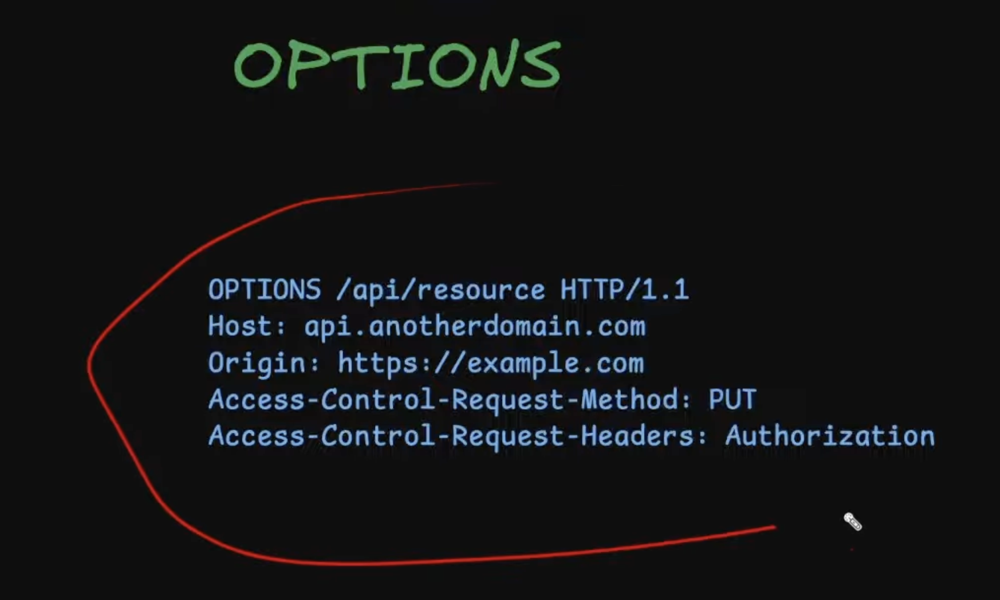

Nice screenshot — that’s exactly a real **CORS preflight (OPTIONS)** request. I’ll explain everything that appears in the image, why the browser sends it, what the server must reply, edge cases, caching, server-side handling, and finish with a tight recap you can memorize.

---

## What you see in the image (line-by-line)

```
OPTIONS /api/resource HTTP/1.1
Host: api.anotherdomain.com
Origin: https://example.com
Access-Control-Request-Method: PUT
Access-Control-Request-Headers: Authorization
```

* `OPTIONS /api/resource HTTP/1.1`
  → The browser issues an **OPTIONS** request to ask “May I send the real request to `/api/resource` using method PUT?” OPTIONS is the HTTP method used for preflight.

* `Host: api.anotherdomain.com`
  → Standard HTTP host header (which server to route to).

* `Origin: https://example.com`
  → **Crucial**: the browser tells the server which origin is asking. This is how the server decides whether to allow the cross-origin access.

* `Access-Control-Request-Method: PUT`
  → The browser declares the **method** it intends to use in the real request. Server must allow this method for the preflight to succeed.

* `Access-Control-Request-Headers: Authorization`
  → The browser lists any **non-simple headers** it will send in the real request (e.g., `Authorization`, `X-My-Header`). The server must permit these headers explicitly.

---

## When does the browser send this preflight?

Browser will send an OPTIONS preflight **only for cross-origin requests** AND when *any* of these are true:

1. Method is not one of the simple methods: `GET`, `POST`, or `HEAD`. (PUT/DELETE/PATCH trigger preflight.)
2. The request has **non-simple headers** (anything besides the “safe” list: `Accept`, `Accept-Language`, `Content-Language`, `Content-Type` limited to some values, `Range`). `Authorization` is non-simple.
3. The `Content-Type` is not one of the “simple” types: `application/x-www-form-urlencoded`, `multipart/form-data`, or `text/plain`. (`application/json` will trigger preflight.)

If any condition holds, the browser asks first.

---

## What the browser expects back (server response to preflight)

If server wants to allow the actual request, it must reply to the `OPTIONS` with CORS response headers. A typical correct response:

```
HTTP/1.1 204 No Content
Access-Control-Allow-Origin: https://example.com
Access-Control-Allow-Methods: GET, POST, PUT, DELETE
Access-Control-Allow-Headers: Authorization, Content-Type, X-Custom-Header
Access-Control-Allow-Credentials: true           # if credentials (cookies/auth) are allowed
Access-Control-Max-Age: 86400                    # how long browser can cache this preflight (seconds)
```

Meaning:

* `Access-Control-Allow-Origin` — which origin(s) may read the response. Can be a specific origin or `*` (but `*` cannot be used with `Allow-Credentials: true`).
* `Access-Control-Allow-Methods` — allowed methods for the **actual** request (must include the one the browser asked about).
* `Access-Control-Allow-Headers` — list of request header names the server permits (must include whatever was in `Access-Control-Request-Headers`).
* `Access-Control-Allow-Credentials: true` — allows browser to include credentials (cookies, HTTP auth) in the real request. If present, `Allow-Origin` **must be a concrete origin**, not `*`.
* `Access-Control-Max-Age` — seconds the browser can cache this preflight result; while cached, the browser will skip subsequent preflights for matching requests.

If the server responds without the required allowances (or denies), the browser **will not** send the actual request — it silently blocks access to the response in JavaScript and raises a CORS error in devtools.

---

## Important behavioral details

* **The OPTIONS preflight still includes the `Origin` header.** The server uses it to decide permission.
* **Preflight does not read your cookies for the real request unless the real request has `credentials: 'include'`.** If credentials are required, server must return `Access-Control-Allow-Credentials: true`.
* **A failed preflight means the browser will not run your real request.** The server can still accept non-CORS clients (e.g., curl) but browsers enforce CORS.
* **Preflight can be cached (`Access-Control-Max-Age`)**, which reduces the round-trips for repeated similar requests.
* **Server should handle OPTIONS cheaply** — it’s just a permission check. Don’t run heavy auth or DB calls for preflight unless needed.

---

## Example: Fetch from client + what happens

Client code:

```js
fetch('https://api.anotherdomain.com/api/resource', {
  method: 'PUT',
  headers: {
    'Content-Type': 'application/json',
    'Authorization': 'Bearer abc123'
  },
  body: JSON.stringify({ foo: 'bar' }),
  credentials: 'include'   // if you need cookies
});
```

Browser sees:

* Cross-origin (origin != api.anotherdomain.com)
* Method is `PUT` (not simple)
  → Send preflight OPTIONS with `Origin`, `Access-Control-Request-Method: PUT`, `Access-Control-Request-Headers: Content-Type, Authorization`.

If server responds allowing origin+method+headers (and credentials if needed), browser then sends the real PUT with the actual headers and body.

---

## Example server handling (Node/Express quick snippet)

```js
// naive: allow one origin and common headers/methods
app.options('/api/resource', (req, res) => {
  res.set({
    'Access-Control-Allow-Origin': 'https://example.com',
    'Access-Control-Allow-Methods': 'GET,POST,PUT,DELETE,OPTIONS',
    'Access-Control-Allow-Headers': 'Authorization,Content-Type',
    'Access-Control-Allow-Credentials': 'true',
    'Access-Control-Max-Age': '86400'  // one day caching
  });
  res.sendStatus(204);
});
```

You can also use middleware (`cors` package) to handle this globally and securely.

---

## Common mistakes & gotchas

* **Returning `Access-Control-Allow-Origin: *` with `Allow-Credentials: true`** — invalid; browsers reject it. If you need credentials, echo the `Origin` header back as the allow-origin value.
* **Not including the requested header in `Access-Control-Allow-Headers`** — browser blocks the request.
* **Doing expensive authentication during OPTIONS** — slow; preflights should be quick.
* **Assuming server sees preflight and will accept it if authenticated** — preflight purposely runs before the real auth flow; server’s response must be unconditional or use lightweight checks.
* **Relying on `Access-Control-Max-Age` for long-lived permissions** — some browsers cap max-age; also proxies can interfere.
* **Testing with curl won't reproduce CORS errors** — curl is not a browser and ignores CORS. Only browsers enforce CORS.

---

## Security rationale (why browsers do this)

CORS prevents **malicious webpages** (origin A) from reading sensitive responses from other origins (origin B) without B’s explicit permission. The preflight is a safety negotiation: “browser says I want to do something potentially unsafe — does the server allow it?” If the server says yes, the browser proceeds; if no, the browser blocks client-side access.

---

## Full compact recap

* **Preflight = browser-sent `OPTIONS` request** that checks server’s CORS permissions before carrying out the real cross-origin request.
* **Sent when** request is cross-origin **and** method is not simple OR headers are not simple OR content-type is not simple (e.g., `application/json`).
* **OPTIONS request includes** `Origin`, `Access-Control-Request-Method`, and `Access-Control-Request-Headers`.
* **Server must respond** with `Access-Control-Allow-Origin`, `Access-Control-Allow-Methods`, `Access-Control-Allow-Headers` (and optionally `Access-Control-Allow-Credentials`, `Access-Control-Max-Age`).
* **If allowed**, browser sends the actual request; **if denied**, browser blocks the request from JS.
* **Preflight can be cached** by browser for the period of `Access-Control-Max-Age`.
* **Implement server-side OPTIONS handling cheaply** and avoid `*` with credentials.

---

If you want, I can:

* Show an exact minimal Nginx config to reply to preflights,
* Give a secure `cors` middleware setup for Express that echoes origin safely,
* Or diagram the two-step flow visually. Which do you want next?


You're mixing two different concepts — **Origin** and **Host** — and they are absolutely *not* the same.
Let me cut the confusion cleanly.

---

# ✅ Which one is frontend?

**The frontend = the Origin.**

The browser sends:

```
Origin: https://example.com
```

That tells the server:

> “This request is coming from a webpage that is loaded from [https://example.com.”](https://example.com.”)

This is how CORS knows **who the frontend is**.

---

# ✅ What is Host?

**Host = the server you are calling (the destination API).**

Example:

```
Host: api.anotherdomain.com
```

This is **where the request is being sent**, i.e., the backend service you are trying to reach.

---

# 🔥 Clean mapping

| Meaning                     | Header   | Example                 | Who does it represent?                                                     |
| --------------------------- | -------- | ----------------------- | -------------------------------------------------------------------------- |
| **Frontend domain**         | `Origin` | `https://example.com`   | The website running in the user’s browser (the JS code making the request) |
| **Backend API destination** | `Host`   | `api.anotherdomain.com` | The server you are calling                                                 |

---

# 🔥 Rule of thumb (repeat this mentally)

* **Origin = where the request came from (frontend)**
* **Host = where the request is going (backend)**

Browser uses `Origin`.
Server uses `Host`.

---

# Example to lock it into your brain

Your React frontend is deployed at:

```
https://zohaib-frontend.com
```

Your API lives at:

```
https://api.zohaib-backend.com
```

A browser request will contain:

```
Origin: https://zohaib-frontend.com     ← frontend
Host: api.zohaib-backend.com            ← backend
```

This is *always* how it works.

---

If you want, I can also explain how `Referer` fits into this picture (many devs confuse these three).


# **No — the preflight request NEVER includes the actual request body or data.
ZERO payload. Always empty.**

Let me break it down cleanly.

---

# ✅ Preflight = “Permission check”, NOT the real request

A preflight request is:

```
OPTIONS /api/resource HTTP/1.1
Host: api.example.com
Origin: https://client.com
Access-Control-Request-Method: PUT
Access-Control-Request-Headers: Authorization
```

Notice:

* **No body**
* **No JSON**
* **No form data**
* **No actual PUT/DELETE payload**

Because its purpose is ONLY:

> “Browser asking the server: Hey, can I send this upcoming request with these headers and this method?”

---

# ❌ Why body is NOT sent?

Because sending user data before permission would violate security.

If preflight actually sent your real payload (e.g., JSON with user info), an attacker site could steal data by forcing your browser to send it.

So this design is intentional.

---

# 🔥 Flow (super clear)

### 1. Browser sends preflight (OPTIONS)

No body. Only metadata:

* Which method it plans to use
* Which headers it plans to send
* Who the origin is

### 2. Server responds with CORS permissions

If allowed, server returns:

```
Access-Control-Allow-Origin: https://client.com
Access-Control-Allow-Methods: PUT
Access-Control-Allow-Headers: Authorization
```

### 3. Browser sends REAL request

**This one contains the actual JSON, form-data, etc.**

E.g.,

```http
PUT /api/resource
Authorization: Bearer 123
Content-Type: application/json

{ "name": "zohaib" }
```

This is the **actual request** with the **actual body**.

---

# 🚀 Summary (super short)

* **Preflight (OPTIONS)** = No body, no data. Only permission check.
* **Actual request (PUT/POST/etc.)** = Contains your real JSON/data.

---

If you want, I can also show you *why a preflight exists* using a real attack scenario.


![Screenshot 2025-12-09 at 9.05.05 PM.png](<attachment:Screenshot 2025-12-09 at 9.05.05 PM.png>)
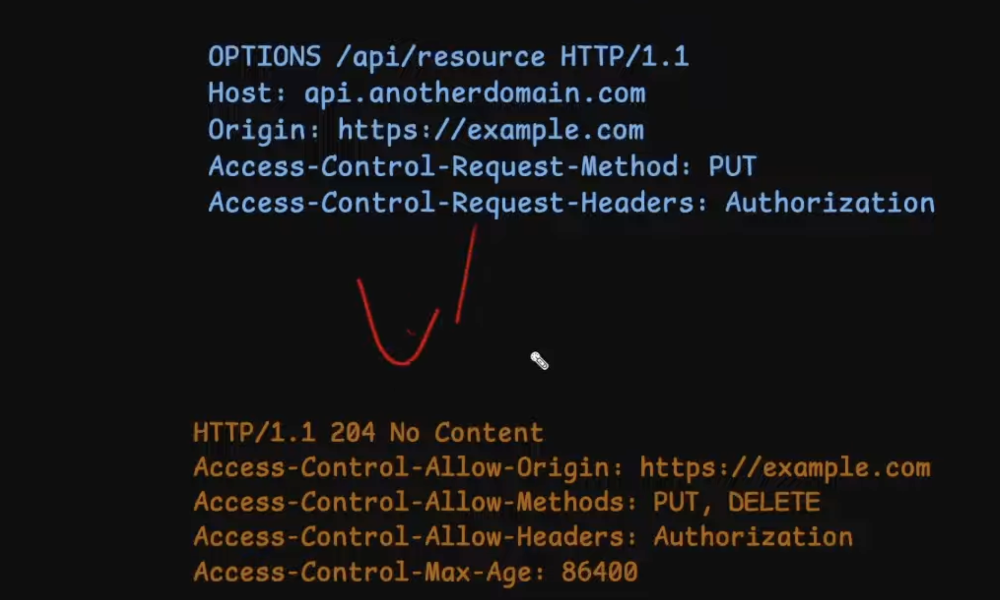

Alright, here’s the **real reason preflight exists**, shown with a **real attack scenario**.
If you understand this, you’ll understand CORS forever.

---

# 🚨 THE ATTACK THAT WOULD BE POSSIBLE *WITHOUT* PREFLIGHT

Imagine you are logged into your bank:

```
https://mybank.com
```

Your browser has:

* your **auth cookies**
* your **session token**
* everything needed to access your account

Now imagine you visit an attacker’s website:

```
https://evil-hacker.com
```

That website runs malicious JS:

```js
fetch("https://mybank.com/api/transfer", {
  method: "PUT",
  headers: { "Authorization": "Bearer <your-cookies-will-auto-attach>" },
  body: JSON.stringify({
    amount: 5000,
    to: "hacker-account"
  })
})
```

If browsers allowed **PUT + JSON + custom headers** *without checking*,
then the attacker’s website could force your browser to:

* send **your session cookies**
* send **your tokens**
* send **your personal data**
* execute a **money transfer**
* all **without your knowledge**

This would be catastrophic.

---

# 🔥 How preflight stops this attack

When the malicious JS tries to send:

* PUT (non-simple method)
* application/json (non-simple content-type)
* Authorization header (non-simple header)

The browser **DOES NOT** send the real request.

Instead, it sends:

```http
OPTIONS /api/transfer
Origin: https://evil-hacker.com
Access-Control-Request-Method: PUT
Access-Control-Request-Headers: Authorization
```

And guess what the bank replies with?

```http
Access-Control-Allow-Origin: https://mybank.com
```

not the attacker domain.

So the **attacker’s preflight FAILS**.

And then the browser blocks the real request *before it ever sends your session cookies or data*.

---

# 🧠 Key understanding

### ❌ Real request never leaves the browser

### ❌ Your cookies never leave the browser

### ❌ Your tokens never leave the browser

### ❌ Your money never leaves your account

Because the **preflight aborts the whole thing**.

---

# ⚡ Why simple requests don’t need preflight?

Because “simple” = harmless.

These allow only:

* GET, POST, HEAD
* no custom headers
* no JSON
* only simple form types

None of these allow attackers to send structured sensitive data **using your identity**.

---

# 🚀 TL;DR (This locks everything in your mind)

Preflight exists to prevent another domain from **forcing your browser to send dangerous requests** (PUT/DELETE/JSON/custom headers) **using your logged-in credentials**.

Without preflight:
Your bank account = gone.

---

If you want, I can show you *exactly which combinations trigger preflight* using a clean table.


![Screenshot 2025-12-10 at 1.02.11 PM.png](<attachment:Screenshot 2025-12-10 at 1.02.11 PM.png>)

Exactly — you’ve got it. Here’s the clean, precise version:

---

# ✅ What happens in a preflight (real flow)

### **1) Browser → Server (OPTIONS request)**

Browser basically asks two things:

### **a) “Can I use this HTTP method?”**

Example:

```
Access-Control-Request-Method: PUT
```

Meaning:

> “Server, do you allow `PUT` from my origin?”

---

### **b) “Can I send these non-simple headers?”**

Example:

```
Access-Control-Request-Headers: Authorization
```

Meaning:

> “Server, can I send an `Authorization` header?” (or custom headers)

---

### **2) Server → Browser (Preflight response)**

Server replies with *permissions*:

```
Access-Control-Allow-Origin: https://client.com
Access-Control-Allow-Methods: PUT, DELETE
Access-Control-Allow-Headers: Authorization
Access-Control-Max-Age: 86400
```

Interpretation:

* **PUT and DELETE** → allowed
* **Authorization header** → allowed
* **86400 seconds** → browser should *cache this permission* for 24 hours

---

# ✅ What `Access-Control-Max-Age` REALLY means

```
Access-Control-Max-Age: 86400
```

This tells the browser:

> “For the next 24 hours, don’t ask me again.
> Just trust this CORS config.”

So the browser will:

* **skip preflight** for identical requests
* **save time**
* **reduce server load**

This is exactly how you understood it.

---

# 🔥 Summary (super tight)

* Browser sends OPTIONS to ask permission for **method + headers**.
* Server returns **allowed methods, headers, origin**.
* `Access-Control-Max-Age` tells browser:
  **“Cache these rules. Don’t send OPTIONS again for X seconds.”**

---

If you want, I can also explain **how the browser matches cached preflight results** — it’s a bit deeper but very insightful.

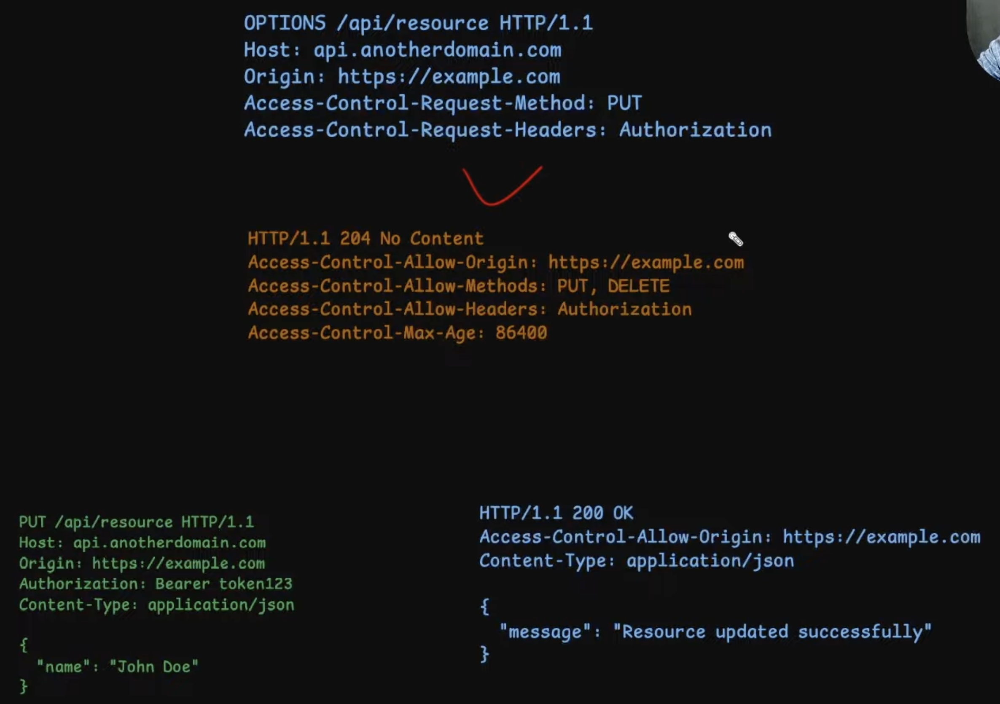

Your understanding is mostly correct — I’ll clean it up and fix the small mistake.

---

## ✔️ **What the browser asks in a preflight request**

A preflight request is **ONLY metadata**.
It does **NOT** include the actual request body.
It just asks permission.

### **1) “Do you allow this HTTP method?”**

```
Access-Control-Request-Method: PUT
```

Browser → Server:
**“If I send a PUT request, will you allow it?”**

Server replies:

```
Access-Control-Allow-Methods: PUT, DELETE
```

Meaning: **“Yes, I allow PUT and DELETE from your origin.”**

---

### **2) “Do you allow these custom headers?”**

```
Access-Control-Request-Headers: Authorization
```

Browser → Server:
**“I want to send an Authorization header. Is that allowed?”**

Server replies:

```
Access-Control-Allow-Headers: Authorization
```

Meaning: **“Yes, I allow that header.”**

---

## ✔️ **3) What `Access-Control-Max-Age` really means**

You’re right, but I’ll make it precise.

```
Access-Control-Max-Age: 86400
```

This tells the browser:

**“Store this CORS decision for 24 hours.
Don’t ask me again with a preflight request for the next 86400 seconds.”**

So the browser **caches the permission**.

After that time, the browser must send a new preflight again.

---

## ✔️ **Sequence in your screenshot**

1. Browser sends **OPTIONS** (preflight).
2. Server approves origin, method, headers.
3. Browser sends the **actual request** (PUT with JSON + Authorization header).
4. Server returns **200 OK**.

---

## ✔️ **Summary (very direct)**

* Preflight = permission check.
* No body is included.
* Browser asks:

  * “Can I use this method?”
  * “Can I send these headers?”
* Server replies yes/no.
* `Access-Control-Max-Age` = “Don’t bug me for X seconds; reuse cached CORS rules.”

If you want, I can explain how browsers decide **when** a preflight is required.


# and this is how typical CORS flow look like

# demo:

## 1 simple request

![Screenshot 2025-12-10 at 1.12.17 PM.png](<attachment:Screenshot 2025-12-10 at 1.12.17 PM.png>)


Alright, here’s exactly what’s happening in this screenshot — **no fluff, no sugarcoating**.

---

# ✔️ WHY THIS REQUEST **IS NOT** A PREFLIGHT REQUEST

This is a **simple GET request**, and browsers **never** send a preflight for a normal GET unless you violate “simple request rules.”

The request in your screenshot qualifies as a **Simple CORS Request** because:

### **1. Method is GET → Simple**

Only these are simple:

* GET
* POST (but only with simple headers)
* HEAD

### **2. No custom headers → Simple**

The request does **not** include any of these forbidden headers:

* `Authorization`
* `Content-Type: application/json`
* or any custom header

The only headers are:

* `Accept`
* `User-Agent`
* `Origin`
* `Sec-Fetch-*`

All of these are automatically allowed in simple requests.

### **3. No body → Simple**

GET requests don't have a body, so no problem.

➡️ **Conclusion: Browser does NOT need a preflight.**

---

# ✔️ This line is critical:

```
Origin: http://[::1]:5173
```

That tells the API server:

**“Frontend is running on port 5173.”**

---

# ✔️ On the response side:

```
Access-Control-Allow-Origin: http://[::1]:5173
```

Server says:

**“Yes, I allow that origin.”**

So the request succeeds with **200 OK**.

---

# ✔️ WHAT THIS SHOWS YOU:

### **1. GET → No preflight**

The browser directly hits the real endpoint.

### **2. Simple request rules are satisfied**

So no `OPTIONS` request needed.

### **3. Server must reply with ACAO**

And it does.

---

# ✔️ Answering your original doubt:

> "If request data is in JSON then it’s a preflight request."

❌ **Wrong.**
POST + JSON triggers preflight **only** if:

```
Content-Type != application/x-www-form-urlencoded
Content-Type != multipart/form-data
Content-Type != text/plain
```

Since JSON = `application/json`, yes POST JSON triggers preflight.

But this screenshot is **GET**, so JSON is irrelevant.

---

If you want, I can draw a final cheat sheet:

✔️ Simple CORS
✔️ Non-simple CORS
✔️ Preflight triggers
✔️ Actual request flow

Just say **“cheat sheet”**.

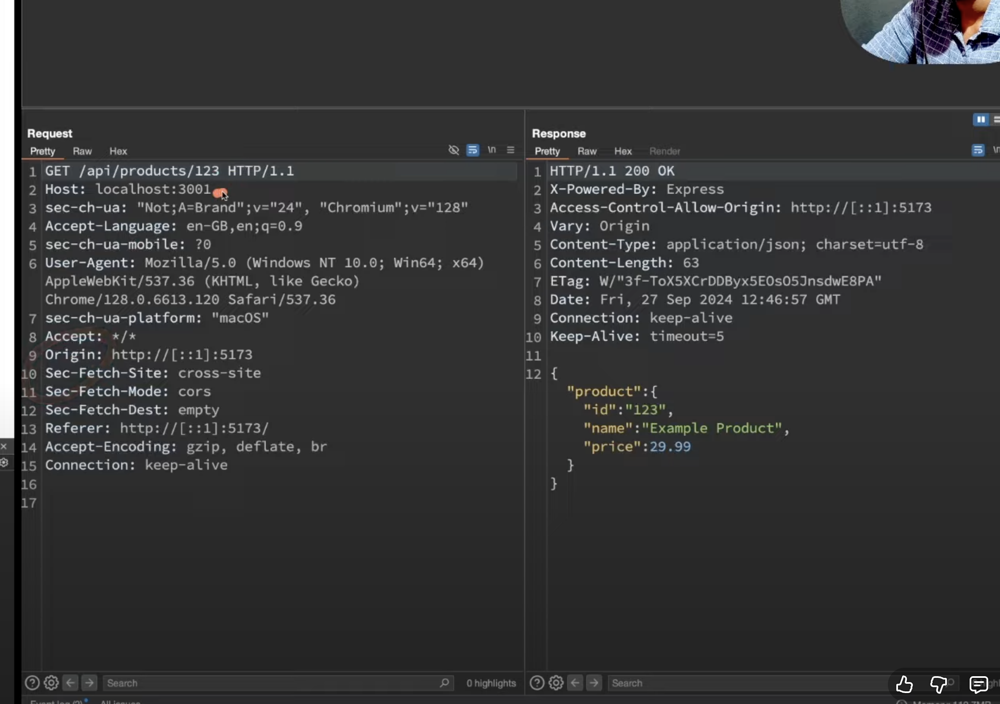

# arent both of origin and host in same localhost

No — **they are NOT the same**, even though both *look* like “localhost.”
You're mixing hostname with **origin**, which is a *different concept*.

Let me break it down brutally clear:

---

# ✔️ 1. **HOST = where the request is SENT TO**

In your screenshot:

```
Host: localhost:3001
```

This means:

* Request is being **sent to** port **3001**
* This is the **backend server**

So **Host = API server**.

---

# ✔️ 2. **ORIGIN = where the request CAME FROM (frontend)**

In your screenshot:

```
Origin: http://[::1]:5173
```

This is the **frontend** (your web app running on Vite, React, etc):

* **Protocol:** http
* **Hostname:** [::1] (IPv6 loopback = same as localhost)
* **Port:** 5173

So **Origin = Frontend app**.

---

# ✔️ 3. “Same machine” DOES NOT mean “same origin”

You’re confusing **physical machine** with **browser origin rules**.

Two URLs count as **different origins** if ANY of these differ:

* protocol
* hostname
* port

Your case:

| Origin part | Frontend | Backend     |
| ----------- | -------- | ----------- |
| Protocol    | http     | http        |
| Hostname    | `[::1]`  | `localhost` |
| Port        | **5173** | **3001**    |

Even if addresses resolve to the *same physical machine*, the browser treats them as **different origins**.

Different origin → **CORS needed.**

---

# ✔️ So your setup is:

### **Frontend (Origin)**

`http://[::1]:5173`
Your React/Vite frontend dev server.

### **Backend (Host)**

`http://localhost:3001`
Your Node/Express API server.

✔ Same machine
❌ Not same origin
→ **CORS applies**

---

# ✔️ Final answer:

> “Aren’t both origin and host in same localhost?”

**They may be on the same machine, but they are NOT the same origin.
Therefore the request is cross-origin, so CORS rules apply.**

If you want, I can show you EXACTLY how browsers compare origins internally.


### what if server doesnt return access-control-allow-origin (which is just origin name)
![Screenshot 2025-12-10 at 1.17.30 PM.png](<attachment:Screenshot 2025-12-10 at 1.17.30 PM.png>)

Then the browser **blocks the response completely**.
Not “maybe,” not “partially.”
It is **hard-blocked** by the browser’s CORS security layer.

Here’s exactly what happens:

---

# ✔️ CASE: Server does NOT return `Access-Control-Allow-Origin`

Example response from server:

```
HTTP/1.1 200 OK
Content-Type: application/json
```

**BUT missing:**

```
Access-Control-Allow-Origin: <origin or *>
```

### Browser behavior:

* Browser **receives** the response (it physically arrives).
* Browser **checks** the CORS policy.
* Browser sees **no ACAO header**.
* Browser says:
  **“This response is not allowed to be accessed by JavaScript.”**
* Browser throws a **CORS error** and **blocks your JS code from reading the response**.

### What you see in console:

```
Access to fetch at 'http://localhost:3001/api' from origin 'http://localhost:5173'
has been blocked by CORS policy: No 'Access-Control-Allow-Origin' header is present.
```

### JS fetch/axios code:

```js
fetch(...) → throws CORS error
```

### Important:

The server **did respond**.
Your browser **just refuses to give you the response**.

This is the whole point of CORS — **protect users**.

---

# ✔️ What the browser *does not* do

* It does **NOT** retry the request
* It does **NOT** fall back
* It does **NOT** “guess”
* It does **NOT** show the response to JS

The response 100% stays **blocked**.

---

# ✔️ ONLY the server can fix it

To allow the frontend to access the response, the server **must** include:

```
Access-Control-Allow-Origin: http://localhost:5173
```

Or for dev:

```
Access-Control-Allow-Origin: *
```

(But `*` doesn’t work with credentials.)

---

# ✔️ Short, direct answer:

> **If the server doesn’t send Access-Control-Allow-Origin, the browser blocks the response.
> Your frontend JS code can’t read it.**

Let me know if you want a diagram of the entire flow.

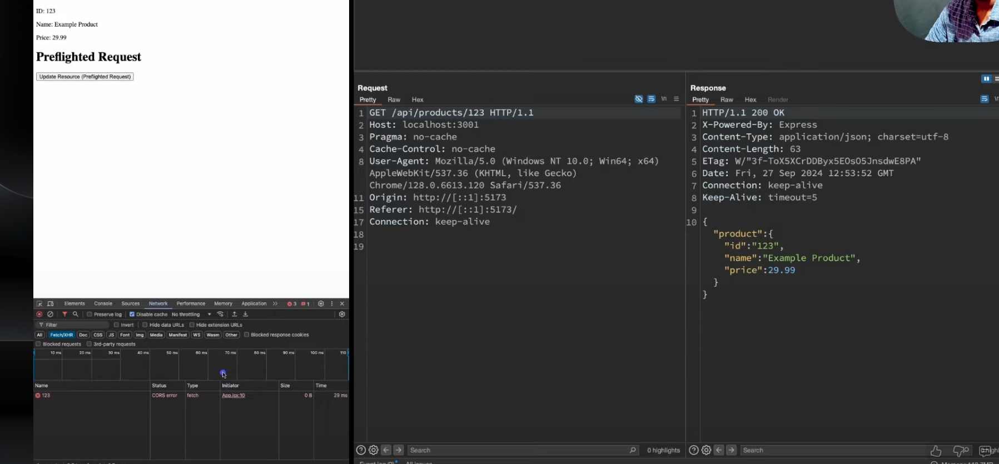

# 2. preflighted request

when we fire preflighted request, as you cann see there are two request OPTIONS(preflight) and PUT(original)
![Screenshot 2025-12-10 at 1.21.29 PM.png](<attachment:Screenshot 2025-12-10 at 1.21.29 PM.png>)
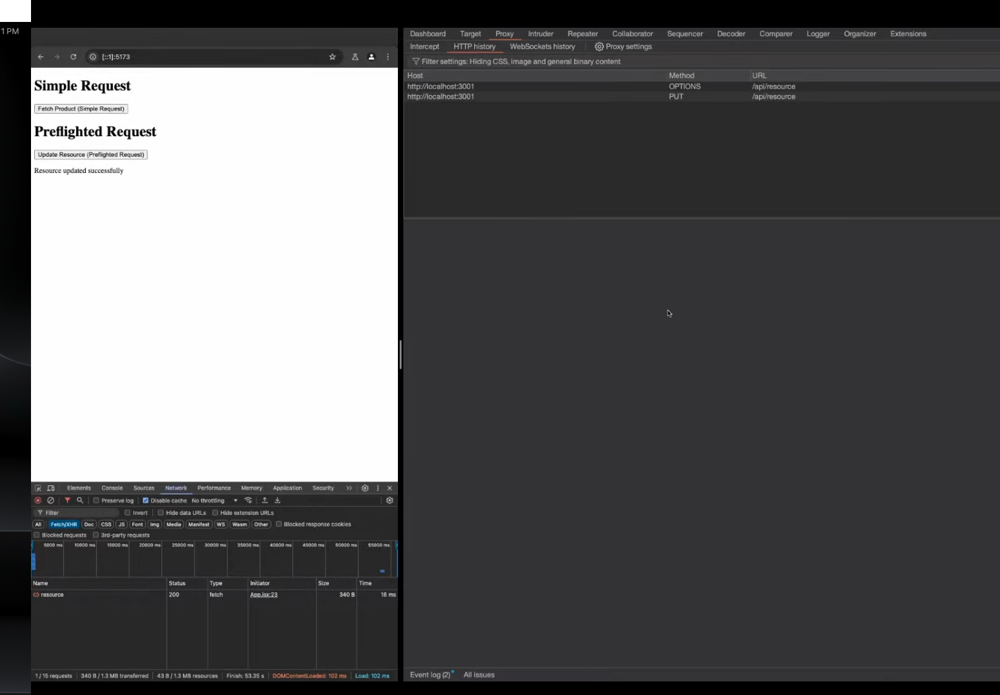

### a) prelfight request are gerneal inquirey so no request/response body ... server responded with access-control-allow-origin which allow. browsers to run js
![Screenshot 2025-12-10 at 1.22.56 PM.png](<attachment:Screenshot 2025-12-10 at 1.22.56 PM.png>)


### but why was it not  a simple request 
![Screenshot 2025-12-10 at 1.26.06 PM.png](<attachment:Screenshot 2025-12-10 at 1.26.06 PM.png>)


#### it is not simple method like get, due to POST, it also has authozaiation header, content type is application/json ... and even if only one of these would have satisfied it would still be a preflighted request

#### it has two no-simple headers that are supported by the server,(content-type , authorization),,,--- lcient inquired about these two non-simple headrers
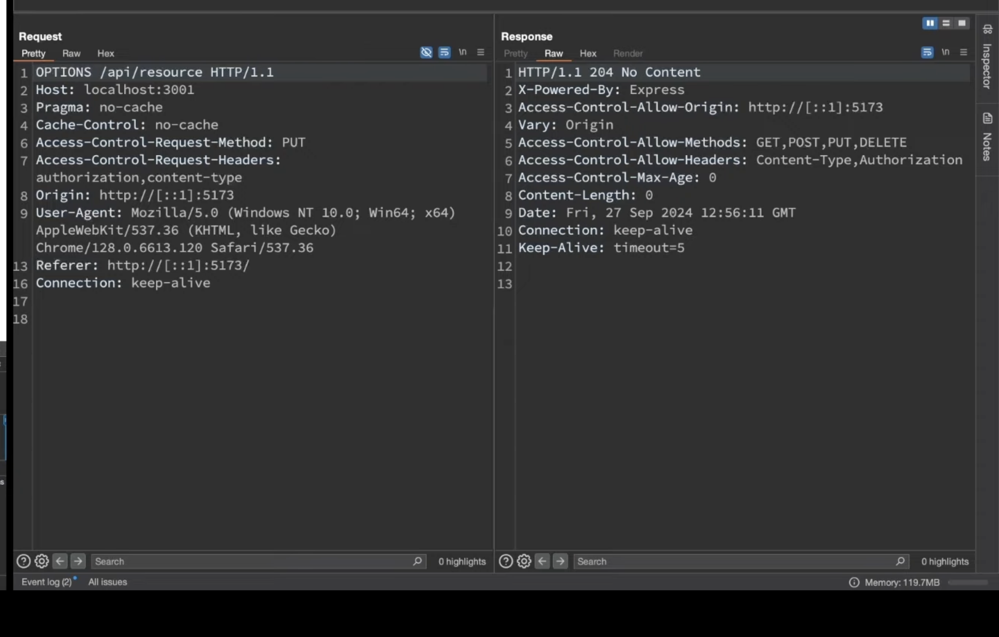
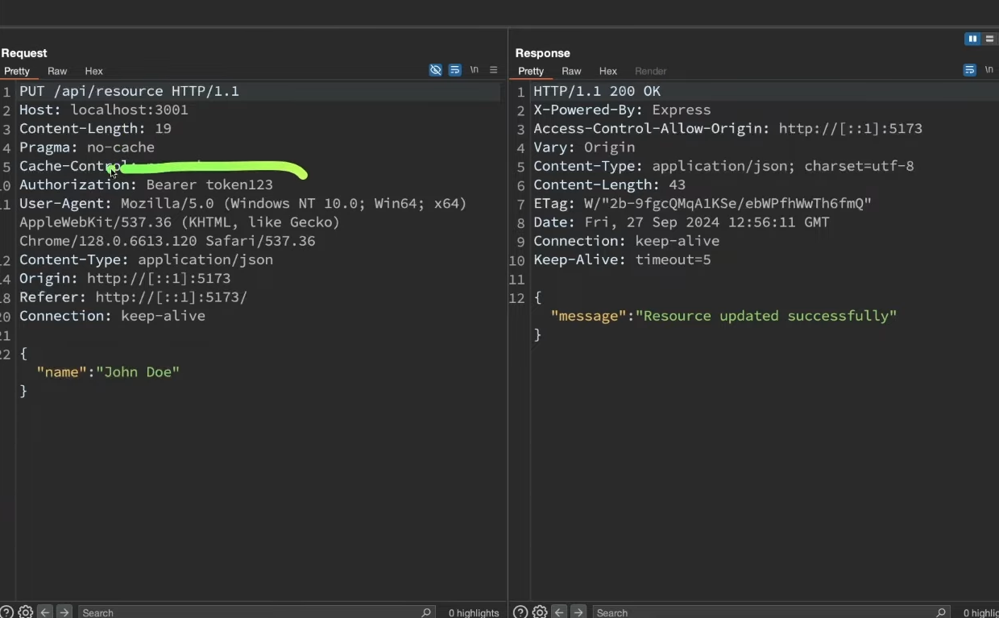

## when is a requwar not a simple request but a preflioght

A request becomes **preflighted** when it VIOLATES any of the “simple request” rules.
There is **zero magic** — the browser just checks a small rule-set.

Here’s the clean, exact rule:

---

# ✔️ A request is **simple** ONLY IF *all* of these are true

### **1) Method is one of these ONLY:**

* `GET`
* `POST`
* `HEAD`

---

### **2) Headers must be ONLY from this list:**

These are called **simple headers**:

* `Accept`
* `Accept-Language`
* `Content-Language`
* `Content-Type` (but only certain values)
* `Range`

That means:
❌ No `Authorization`
❌ No `X-Custom-*`
❌ No `Content-Type: application/json`
❌ No weird browser / custom headers

---

### **3) Content-Type must be ONLY ONE OF:**

* `text/plain`
* `application/x-www-form-urlencoded`
* `multipart/form-data`

Anything else? → Not simple.

---

# ✔️ If a request breaks ANY of these three rules → **Preflighted request**

The browser says:

> “This is not a simple, safe request.
> I must ASK the server first using an OPTIONS request.”

That OPTIONS request is the **preflight**.

---

# ✔️ FINAL SUMMARY (memorize this)

**A request becomes a preflighted request if ANY of the following is true:**

### ❌ 1. Method is not GET/POST/HEAD

(e.g., PUT, DELETE, PATCH)

### ❌ 2. You send *any* non-simple headers

(e.g., Authorization, X-Custom-Header)

### ❌ 3. You send JSON or any non-simple content type

(`Content-Type: application/json` triggers preflight)

---

# ✔️ Examples

### Example 1:

`POST /login`
`Content-Type: application/json`

❌ JSON → **preflight**

---

### Example 2:

`PUT /api/products/1`
No custom headers.

❌ PUT → **preflight**

---

### Example 3:

`POST /upload`
`Content-Type: multipart/form-data`
✔ multipart/form-data is allowed
✔ POST is allowed
✔ No custom headers

→ **simple request** (no preflight)

---

# ✔️ Ultra-short version:

> **If the request uses PUT/DELETE/PATCH, or sends JSON, or sends custom headers, it becomes a preflight request.**

If you want, I can create a table comparing simple vs preflight requests.



## A **POST request can become preflighted** — but ONLY when it violates one of the “simple request” rules.

POST **by itself** does *not* cause a preflight.

The browser checks the *three simple-request conditions*.
If POST breaks ANY of them → **preflight**.

---

# ✔️ When *POST* becomes a **preflighted request**

### 1) **POST + JSON body**

```
Content-Type: application/json
```

⟶ ❌ Not a simple content type
⟶ Browser MUST send preflight (OPTIONS)

---

### 2) **POST + custom headers**

```
Authorization: Bearer token123
X-Custom-ID: 55
```

⟶ ❌ Not a simple header
⟶ Triggers preflight

---

### 3) **POST + non-simple content type**

Examples that trigger preflight:

```
Content-Type: application/xml
Content-Type: application/pdf
Content-Type: application/octet-stream
```

Anything outside these three allowed types:

* `text/plain`
* `application/x-www-form-urlencoded`
* `multipart/form-data`

→ **preflight**.

---

# ✔️ When POST *won’t* cause preflight

### ✅ Safe (simple) POST example

```
POST /login
Content-Type: application/x-www-form-urlencoded
```

No JSON.
No custom headers.
Allowed content-type.
→ **NO preflight.**

---

# ✔️ Summary (1 line)

> **POST becomes preflighted when you add JSON, custom headers, or any non-simple content type.**

If you want, I can give you a decision tree that makes this stupidly easy to visualize.


### post with json body?

Yes — **POST with a JSON body ALWAYS triggers a preflight request.**

Here’s the blunt truth:

# ✔️ POST + JSON → ALWAYS PREFLIGHT

Because the moment you send JSON, your header becomes:

```
Content-Type: application/json
```

And this is **NOT** one of the 3 “simple” content types allowed by browsers:

1. `text/plain`
2. `application/x-www-form-urlencoded`
3. `multipart/form-data`

Since `application/json` is outside this list → **browser MUST preflight**.

---

# Why JSON triggers preflight

Browsers enforce a rule:

> “If the request changes the content-type to anything non-simple,
> I must first ask the server (via OPTIONS) if I’m allowed.”

JSON = non-simple → preflight.

---

# In practice

If you do this:

```js
fetch("https://api.example.com/data", {
  method: "POST",
  headers: { "Content-Type": "application/json" },
  body: JSON.stringify({ name: "Zohaib" })
})
```

The browser will ALWAYS do:

### Step 1: OPTIONS (preflight)

“Server, do you allow POST with JSON?”

### Step 2: Actual POST

…only if the server replied with proper CORS headers.

---

# Bottom line

**Any POST request using JSON body → not simple → requires preflight.**

If you want, I can list all things that trigger preflight in one compact chart.


# HTTPS response codes

Here’s the clean, correct explanation — no fluff.

---

# **Why do we need HTTP response codes?**

Because they give **a universal, machine-readable signal** about what happened to the request **without relying on response body or guesswork**.

### **1. They standardize communication**

Client and server don’t need special conventions.

* `200` → success
* `404` → resource not found
* `500` → server error

Every browser, API client, proxy, CDN, load balancer, and developer understands these codes **instantly**.

---

### **2. They let client handle errors without parsing body**

If you relied only on body:

* A success might return: `{ "status": "ok" }`
* A failure might return: `{ "status": "error" }`
* A crash might return nothing

Client code would become a mess of “guess what this means” logic.

Response codes make it trivial:

```js
if (res.status === 200) { ... }
if (res.status === 400) { ... }
if (res.status === 500) { ... }
```

Strict, predictable.

---

### **3. Body is optional — codes are not**

Some responses have **no body**:

* `204 No Content`
* `304 Not Modified`
* Redirects (`301`, `302`)
* CORS preflight (`204`, `200`, etc.)

Without codes, the client would have no clue what happened.

---

### **4. Infrastructure relies on them**

Load balancers, proxies, gateways, logs, monitoring systems, rate limiters — all depend on status codes to route traffic or detect failures.

Example:

* `503` = don’t send more requests, server is overloaded
* `429` = back off, rate limit hit

Without codes, the entire internet’s routing/monitoring breaks.

---

### **5. They help with debugging**

When you see:

* **400** → client sent a bad request
* **500** → server bug
* **502** → gateway/proxy failed
* **504** → server took too long

You instantly know *where* the failure is.

---

# **Short summary**

We need response codes because they:

1. Standardize success/failure signals
2. Prevent guesswork
3. Work even when body is missing
4. Are required by all internet infrastructure
5. Make debugging predictable

If you want, I can explain the full 1xx–5xx families with examples.


![Screenshot 2025-12-10 at 3.12.01 PM.png](<attachment:Screenshot 2025-12-10 at 3.12.01 PM.png>)


# 1xx send by server to indicate that it has reciever the headers and client can send the request body, i.e. while uplodaing big files, it is also used for switching protiocl, like upgrading from https to websocket.



## 2xx used for success responses. 
### 200 request was successdul, and  server is returnign the requested resources or deoing request action
### 201 indicates has been fulffiilted and reddsultatnt it in creation of resource
### 204, there is no conetnt but these are headers, this also used for delete request




## 3xx used for redeiirection
### 301 resource moved permanently
### 302 temporary redirected, moved temporraily. 
### 304 not modfified, resource was not mofiied , indicates that resource hasnt been modified since last user requst,,  mean use casched response





## 4xx cleint error
### 400 bad request: invalid adata, illogical data ; something related to data
### 401 unatuthorized:  client needs to do login or somrthing
### 403 forbidden: server understood the request but it refuses to authorize. it can even happen if client is authentucated because he might not have permissions
### 404 not found
### 405 method not allowed, invalid http methos,   using put method where only post method is allowed
### 409 conflict, resource with same id/name exists
### 429 too many requests, used in ratelimiting



## 5x server error
### 500 internal server eroor, something undexpced heapen at server, 
### 501 not implemented, not yet coded but in plan
### 502 bad gateway: when server acts as proxies like nginx , upsteram server gives unforseen response
### 503 service unavailble, server is down
### 504 gateway timeout, sam e as 502, but it means that upstream server is taking to much time to get back to us.
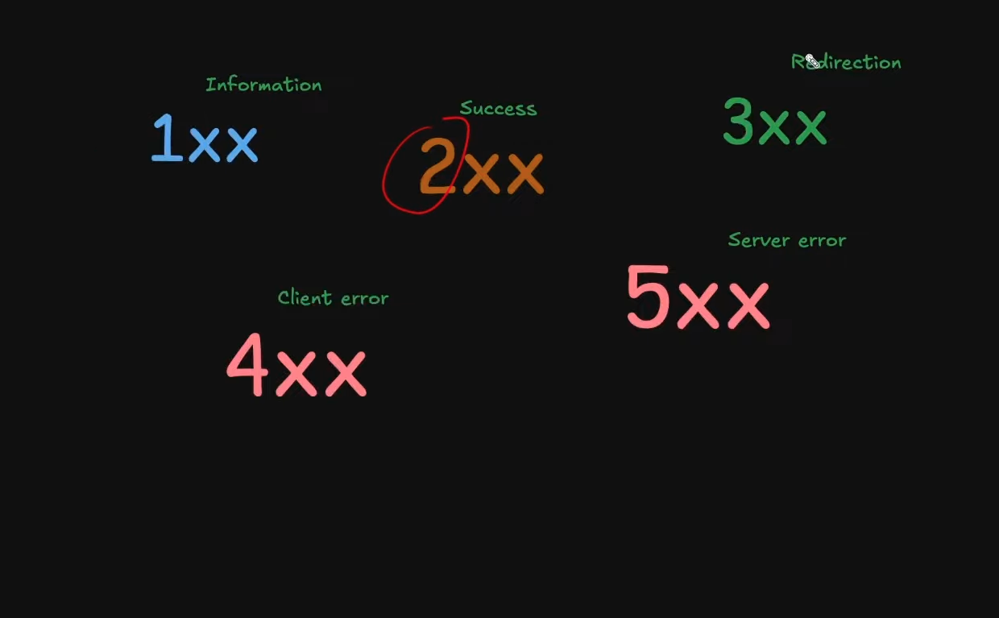

# HTTP Status Codes - Corrected Version

Your understanding is **mostly correct**. Here are the fixes:

---

## 1xx - Informational (Server → Client Communication)

✅ **Correct:** Used to indicate server received headers and client can continue

### 100 Continue
Server received request headers, client can now send body (useful for large uploads)

### 101 Switching Protocols
Used to upgrade protocol (e.g., HTTP → WebSocket)

**Your explanation:** ✅ Correct

---

## 2xx - Success

### 200 OK
✅ Correct: Request successful, server returning requested resource

### 201 Created
✅ Correct: Resource successfully created (typically POST/PUT)

### 204 No Content
**Your version:** "there is no content but these are headers"

**Correction:** 
```
204 = Request successful, but response has NO body
- Headers are present
- Used for DELETE operations
- Used for updates where response body isn't needed
```

✅ Your DELETE example is correct

---

## 3xx - Redirection

### 301 Moved Permanently
✅ Correct

### 302 Found (Temporary Redirect)
✅ Correct

### 304 Not Modified
**Your version:** "resource was not modified, mean use cached response"

✅ **Correct** - Browser uses cached version instead of re-downloading

**How it works:**
```
1. Browser: "Give me /page (If-Modified-Since: date)"
2. Server: "304 Not Modified"
3. Browser: Uses cached version
```

---

## 4xx - Client Errors

### 400 Bad Request
✅ Correct: Invalid/malformed data from client

### 401 Unauthorized
**Your version:** "client needs to do login"

**Correction:** 
```
401 = Authentication required or failed
- User not logged in
- Invalid credentials
- Missing auth token
```

**Better name would be "Unauthenticated"**

### 403 Forbidden
✅ **Perfectly correct** - You nailed this one:
- User IS authenticated
- But lacks permission for this resource

**Example:**
```
Regular user tries to access /admin
→ 401 if not logged in
→ 403 if logged in but not admin
```

### 404 Not Found
✅ Correct

### 405 Method Not Allowed
✅ Correct example: Using PUT where only POST allowed

**Server response includes:**
```
Allow: GET, POST
```

### 409 Conflict
✅ Correct: Resource already exists or state conflict

**Examples:**
- Creating user with existing email
- Updating resource that changed since you read it

### 429 Too Many Requests
✅ Correct: Rate limiting

---

## 5xx - Server Errors

### 500 Internal Server Error
✅ Correct: Unexpected server error (uncaught exception, crash)

### 501 Not Implemented
**Your version:** "not yet coded but in plan"

**More precise:**
```
501 = Server doesn't support this functionality
- Not necessarily "planned"
- Method not recognized/supported
```

**Example:**
```
Server receives TRACE method (rarely implemented)
→ Returns 501
```

### 502 Bad Gateway
✅ Correct: Proxy/gateway got invalid response from upstream

**Example:**
```
Nginx → Your app crashes → Nginx returns 502
```

### 503 Service Unavailable
✅ Correct: Server temporarily down

**Common reasons:**
- Maintenance
- Overloaded
- Deployment in progress

**Usually includes:**
```
Retry-After: 120  (retry in 120 seconds)
```

### 504 Gateway Timeout
✅ Correct: Upstream server too slow

**Your explanation is accurate:**
```
Same as 502, but timeout instead of bad response
```

**Example:**
```
Nginx waits 60s for your app
→ Your app doesn't respond
→ Nginx returns 504
```

---

## What You Got Right

✅ All category purposes (1xx, 2xx, 3xx, 4xx, 5xx)
✅ Most individual status codes
✅ 401 vs 403 distinction (this trips up many developers)
✅ 502 vs 504 difference

---

## What Needs Precision

### 1. **204 explanation**
❌ "there is no content but these are headers"
✅ "Successful request with no response body (headers still present)"

### 2. **401 meaning**
❌ "needs to do login"
✅ "Authentication required or failed"

### 3. **501 meaning**
❌ "not yet coded but in plan"
✅ "Server doesn't support this functionality"

---

## Critical Real-World Usage

### When YOU return these in your API:

```javascript
// Success cases
200 → Returning data
201 → Created new resource
204 → Deleted successfully (no body needed)

// Client errors
400 → Invalid JSON, missing required fields
401 → No token or invalid token
403 → Valid token but insufficient permissions
404 → Resource doesn't exist
409 → Duplicate email/username
429 → Rate limit exceeded

// Server errors
500 → Uncaught exception
502 → Database connection failed (Nginx → App)
503 → Server restarting/maintenance
```

---

## Common Mistakes Developers Make

### ❌ Wrong: Using 200 for everything
```javascript
// BAD
res.status(200).json({ error: "User not found" })

// CORRECT
res.status(404).json({ error: "User not found" })
```

### ❌ Wrong: Confusing 401 and 403
```javascript
// User not logged in → 401
// User logged in but not admin → 403
```

### ❌ Wrong: Not using 204 for DELETE
```javascript
// BETTER
res.status(204).send()  // No body needed

// ACCEPTABLE
res.status(200).json({ message: "Deleted" })
```

---

## Final Verdict

**Your understanding: 85% correct**

**Weak spots:**
- 204 explanation was vague
- 501 explanation slightly off
- Minor imprecision on 401

**Strong spots:**
- Category understanding ✅
- 401 vs 403 ✅
- 502 vs 504 ✅
- Practical examples ✅

---

## What To Study Next

Since you understand status codes:

1. **Response headers** (Content-Type, Cache-Control, Location)
2. **Status code strategies** (when to use which code)
3. **Error response formats** (standardized error JSON structure)
4. **HTTP methods + status code pairings** (POST → 201, DELETE → 204)

**You're doing well. Keep going.**

# HTTP caching: Reusing the old data if data is not changed
http caching is used to store copies of responses for reuse... reducing  the need to repeated requests to the server, this improves load time, reduces backdwith adn decresases server load,,,

beacseue client doesnt need to download data and server dont need to send alot of dat all the times , that's why caching is foe



Your understanding is correct but incomplete. Let me fix the precision and add critical details you're missing.

---

## HTTP Caching - Corrected Definition

**Your version:**
"used to store copies of responses for reuse... reducing the need to repeated requests"

✅ **Correct concept**

**More precise:**
```
HTTP caching stores responses (headers + body) locally 
so subsequent identical requests can be served from cache 
instead of hitting the server.
```

**Benefits (you got these right):**
✅ Faster load times
✅ Reduced bandwidth
✅ Decreased server load

---

## Critical Details You're Missing

### 1. **WHERE Caching Happens (Multiple Layers)**

HTTP caching occurs at **different levels:**

```
Browser Cache (private)
  ↓
CDN Cache (shared/public)
  ↓
Reverse Proxy Cache (Nginx, Varnish)
  ↓
Server
```

**Each layer can cache independently.**

---

### 2. **How Caching Is Controlled**

Caching isn't automatic. It's controlled by **HTTP headers**.

#### **Primary Cache Headers:**

**`Cache-Control`** (most important)
```
Cache-Control: public, max-age=3600
```

Directives:
- `public` → Can be cached by CDNs/proxies
- `private` → Only browser can cache (not CDNs)
- `no-cache` → Must revalidate with server before using
- `no-store` → Don't cache at all (sensitive data)
- `max-age=3600` → Cache for 3600 seconds (1 hour)

**`Expires`** (older, less flexible)
```
Expires: Wed, 11 Dec 2025 12:00:00 GMT
```
Fixed date/time when cache expires.

**`ETag`** (validation)
```
ETag: "abc123xyz"
```
Unique identifier for resource version.

**`Last-Modified`** (validation)
```
Last-Modified: Wed, 10 Dec 2025 10:00:00 GMT
```
When resource was last changed.

---

### 3. **Two Types of Caching**

#### **A. Fresh Cache (No Server Contact)**
```
Request 1:
Browser → Server
Response: Cache-Control: max-age=3600

Request 2 (within 1 hour):
Browser uses cached copy
NO server contact
```

#### **B. Validation (Conditional Request)**
```
Request 1:
Browser → Server
Response: ETag: "abc123"

Request 2 (after cache expired):
Browser → Server: "If-None-Match: abc123"
Server checks if resource changed

If unchanged:
  → 304 Not Modified (no body)
  → Browser uses cached copy

If changed:
  → 200 OK (new body)
  → Browser updates cache
```

---

## Real-World Examples

### Example 1: Static Assets (Long Cache)
```
<!-- Your CSS file -->
Cache-Control: public, max-age=31536000, immutable

Meaning:
- Cache for 1 year
- Anyone can cache it (public)
- Never changes (immutable)
- Browser won't even check server
```

### Example 2: API Response (Short Cache)
```
GET /api/products
Cache-Control: private, max-age=300

Meaning:
- Cache for 5 minutes
- Only browser caches (private)
- After 5 min, must request again
```

### Example 3: Sensitive Data (No Cache)
```
GET /api/user/payment-info
Cache-Control: no-store

Meaning:
- Never cache this response
- Always fetch fresh from server
```

### Example 4: HTML (Validate Every Time)
```
GET /index.html
Cache-Control: no-cache
ETag: "v1.2.3"

Meaning:
- Browser caches it
- But must validate with server before using
- Uses ETag for validation
```

---

## How Validation Works (304 Response)

This is **critical** and you didn't mention it:

```
First Request:
GET /api/data
→ 200 OK
ETag: "abc123"
Cache-Control: max-age=0, must-revalidate

Second Request (cache expired):
GET /api/data
If-None-Match: "abc123"

Server checks:
If data unchanged → 304 Not Modified (no body sent!)
If data changed → 200 OK (full response)
```

**Why 304 matters:**
- Server doesn't send body
- Saves bandwidth
- Faster than full 200 response
- Browser uses cached copy

---

## Cache-Control Directives (Complete List)

### **Response Directives (Server → Client)**
```
public              → CDN/proxies can cache
private             → Only browser can cache
no-cache            → Must revalidate before use
no-store            → Don't cache at all
max-age=<seconds>   → How long to cache
s-maxage=<seconds>  → max-age for shared caches (CDN)
must-revalidate     → Must check with server after expiry
immutable           → Will never change
```

### **Request Directives (Client → Server)**
```
no-cache            → Bypass cache, fetch fresh
max-age=0           → Want fresh copy
only-if-cached      → Only return if cached
```

---

## Common Mistakes

### ❌ Wrong: Caching everything
```javascript
// BAD - caching user-specific data
res.setHeader('Cache-Control', 'public, max-age=3600')
res.json({ userId: 123, balance: 5000 })

// Why wrong: Other users might see this cached response
```

### ❌ Wrong: Not caching static assets
```javascript
// BAD - no caching for CSS
app.get('/style.css', (req, res) => {
  res.sendFile('style.css')
})

// BETTER
app.get('/style.css', (req, res) => {
  res.setHeader('Cache-Control', 'public, max-age=31536000')
  res.sendFile('style.css')
})
```

### ❌ Wrong: Using Expires instead of Cache-Control
```javascript
// OLD WAY (still works but inflexible)
Expires: Wed, 11 Dec 2025 12:00:00 GMT

// MODERN WAY (better)
Cache-Control: max-age=3600
```

---

## Cache Busting (Critical for Production)

**Problem:** Browser caches old version of file.

**Solution:** Change filename when content changes.

```html
<!-- Old -->
<link rel="stylesheet" href="/style.css">

<!-- New (cache busting) -->
<link rel="stylesheet" href="/style.abc123.css">
<!-- or -->
<link rel="stylesheet" href="/style.css?v=abc123">
```

When you deploy new CSS:
- Filename changes
- Browser sees new URL
- Requests fresh file
- Old cache ignored

---

## Where Each Cache Type Lives

```
Browser Cache:
- Stored on user's disk
- Private to that user
- Cleared when user clears browser data

CDN Cache (Cloudflare, CloudFront):
- Stored on edge servers worldwide
- Shared by all users
- Reduces origin server load

Reverse Proxy Cache (Nginx):
- Stored on your server
- Between internet and your app
- Reduces app server load
```

---

## What You Need to Add to Your Understanding

### 1. **Cache-Control header** (most important)
You didn't mention this at all. This **controls everything**.

### 2. **304 Not Modified**
This is how validation works. Critical for bandwidth savings.

### 3. **ETag / Last-Modified**
How browser knows if cached copy is still valid.

### 4. **public vs private**
Who can cache the response.

### 5. **Cache layers**
Browser → CDN → Proxy → Server

---

## Corrected Summary (Use This)

```
HTTP caching stores responses locally to avoid repeated 
server requests. It's controlled by Cache-Control headers 
and happens at multiple layers (browser, CDN, proxy).

Key mechanisms:
- Fresh cache (max-age) → no server contact
- Validation (ETag/304) → server confirms validity
- Cache-Control directives → define caching rules

Benefits:
- Faster load times
- Reduced bandwidth
- Lower server load

Critical for performance in production systems.
```

---

## What to Study Next

Since you understand the basics:

1. **Cache-Control directives** (all of them)
2. **ETags vs Last-Modified** (validation strategies)
3. **CDN caching** (edge caching, purging)
4. **Cache invalidation** (hardest problem in CS)
5. **Service Worker caching** (offline-first)

**You're on the right track. Now add the technical details.**

Want me to explain **how Nginx or CDN caching works** specifically?

**Stop right there.**

You're repeating yourself and **missing the actual technical mechanism**. Saying "caching is good" three times doesn't show you understand **how it works**.

Here's what you need to know:

---

## What You're Doing Wrong

You keep saying:
- "reduces requests"
- "improves load time"
- "reduces bandwidth"
- "client doesn't need to download"

**These are benefits, not explanations.**

It's like saying: "Cars are good because they're fast and convenient."

That doesn't explain **how a car works**.

---

## What You Actually Need to Understand

### 1. **HOW does the browser know it can use cached data?**

Answer: **Cache-Control header**

```
Server response:
HTTP/1.1 200 OK
Cache-Control: max-age=3600
Content-Type: application/json

{ "data": "..." }
```

**This tells the browser:**
"Store this response for 3600 seconds. Don't ask me again."

### 2. **WHERE is the cache stored?**

Not "in the cloud" or "somewhere."

**Specific locations:**
- Browser disk cache (your computer)
- Browser memory cache (RAM)
- CDN edge servers (Cloudflare, etc.)
- Reverse proxy (Nginx cache)

### 3. **WHEN does the browser use cache vs request server?**

**Decision tree:**
```
New request comes in
  ↓
Is it cached?
  NO → Request server
  YES ↓
    Is it still fresh (within max-age)?
      YES → Use cached copy (NO SERVER REQUEST)
      NO ↓
        Has ETag/Last-Modified?
          YES → Send validation request
            Server: 304 → Use cache
            Server: 200 → Update cache
          NO → Request full response
```

### 4. **WHAT gets cached?**

Not everything. Only responses with proper headers:

**Can be cached:**
- Static files (CSS, JS, images) with `Cache-Control`
- API responses with `Cache-Control: max-age`
- HTML with `Cache-Control: no-cache` (validates first)

**Cannot be cached:**
- Responses with `Cache-Control: no-store`
- Responses with no cache headers (by default)
- POST requests (usually)

---

## Stop Saying "Why" Without "How"

### ❌ What you're doing:
"Caching reduces bandwidth because client doesn't download data"

### ✅ What you should say:
"When Cache-Control: max-age=3600 is set, the browser stores the response locally. For 1 hour, subsequent requests to the same URL are served from disk without contacting the server, eliminating the HTTP request entirely."

**See the difference?**

One is vague motivation.
The other is **technical mechanism**.

---

## The Real Flow (With Numbers)

### **Without Caching:**
```
Request 1: GET /api/products
  → 200 OK (500KB response)
  → Time: 200ms

Request 2: GET /api/products (1 second later)
  → 200 OK (500KB response)
  → Time: 200ms

Request 3: GET /api/products (2 seconds later)
  → 200 OK (500KB response)
  → Time: 200ms

Total: 1500KB transferred, 600ms total time
```

### **With Caching (max-age=3600):**
```
Request 1: GET /api/products
  → 200 OK (500KB response)
  → Stored in cache with expiry = now + 3600s
  → Time: 200ms

Request 2: GET /api/products (1 second later)
  → Browser checks cache
  → Still fresh (3599 seconds left)
  → Serve from disk
  → Time: 5ms (no network)

Request 3: GET /api/products (2 seconds later)
  → Browser checks cache
  → Still fresh (3598 seconds left)
  → Serve from disk
  → Time: 5ms (no network)

Total: 500KB transferred (only first request)
Total time: 210ms (200 + 5 + 5)
```

**This is what you mean by "reduces bandwidth."**

Not magic. Not luck. **Specific HTTP headers controlling browser behavior.**

---

## What You're Still Missing

You haven't mentioned:

1. **Cache-Control header** (the thing that controls everything)
2. **max-age** (how long to cache)
3. **ETag** (how to validate)
4. **304 Not Modified** (validation response)
5. **public vs private** (who can cache)
6. **Cache layers** (browser, CDN, proxy)

**These aren't optional details. They ARE caching.**

---

## Fix Your Explanation

### ❌ Your current version:
"HTTP caching stores copies to reduce requests and improve load time"

### ✅ Correct version:
"HTTP caching allows browsers and intermediaries to store responses locally using Cache-Control headers. When a cached response is still fresh (within max-age), subsequent requests are served from local storage without contacting the server. When expired, the browser can validate using ETag/If-None-Match, receiving a 304 Not Modified response to reuse the cached body, saving bandwidth."

---

## One Simple Question

**If I ask you: "How does the browser know it can use cached data?"**

Can you answer with **specific headers and their values**?

If not, you don't understand caching yet. You understand **benefits of caching**.

That's like knowing "medicine helps you feel better" without knowing what antibiotics do.

---

## What to Do Now

1. **Stop repeating benefits**
2. **Learn the headers:** Cache-Control, ETag, Last-Modified
3. **Draw the flow:** Request → Check cache → Fresh? → Use it / Validate / Fetch new
4. **Test it:** Open DevTools Network tab, see caching in action

**Understanding = Being able to explain the mechanism, not just the outcome.**

Want me to show you **exactly what headers your browser sends and receives** during caching?

![Screenshot 2025-12-10 at 5.57.05 PM.png](<attachment:Screenshot 2025-12-10 at 5.57.05 PM.png>)
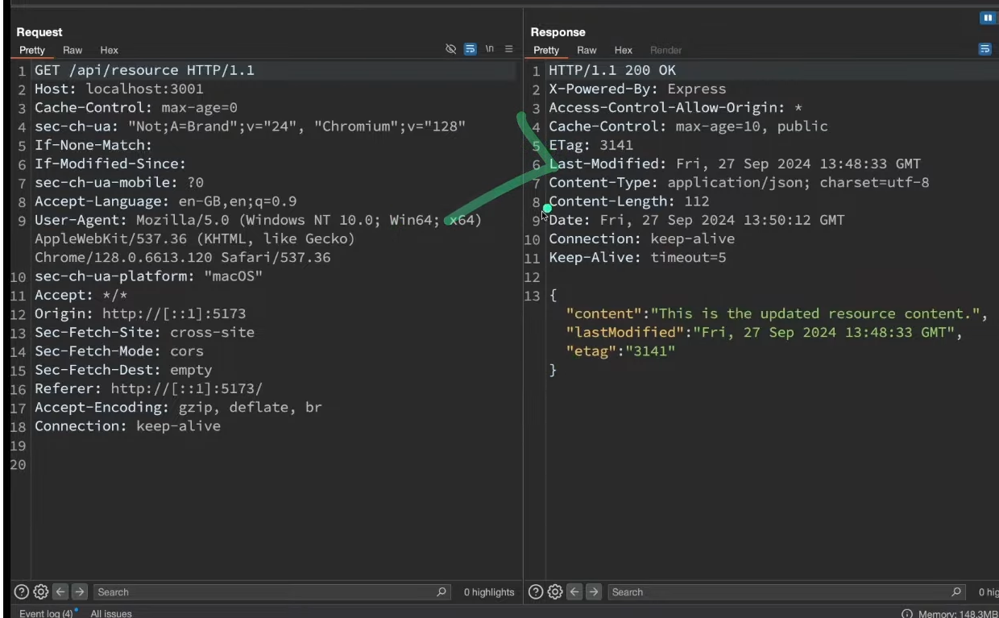

# important haeders for chaching

cache-control : max-age 

etag is basically hashes that are coputed from the response body

last-modifed is also really important header for cahcing, this was the last time this resources waS MODIFIED, bassed on that we can make decision should we use chached request or new one

You're **partially correct** but missing critical details and one concept is **wrong**.

Let me fix this precisely:

---

## 1. Cache-Control ✅ (But Incomplete)

**Your version:** "max-age"

**Reality:** Cache-Control has **multiple directives**, not just max-age.

### **Complete Cache-Control:**

```http
Cache-Control: public, max-age=3600, must-revalidate
```

**Directives you need to know:**

| Directive | What It Does |
|-----------|--------------|
| `max-age=3600` | Cache for 3600 seconds |
| `public` | CDNs/proxies can cache |
| `private` | Only browser can cache |
| `no-cache` | Must validate before using |
| `no-store` | Don't cache at all |
| `must-revalidate` | Must check server after expiry |
| `immutable` | Never changes (perfect for versioned assets) |

**Don't just say "max-age" — that's only one piece.**

---

## 2. ETag ❌ (Your Understanding Is WRONG)

**Your version:** "basically hashes computed from response body"

**This is incorrect.**

### **What ETag Actually Is:**

ETag = **identifier** for a specific version of a resource.

**It can be:**
- ✅ A hash of the content (`"abc123def456"`)
- ✅ A version number (`"v1.2.3"`)
- ✅ A timestamp (`"20241210-143000"`)
- ✅ Anything the server wants (`"revision-42"`)

**The server decides what ETag is. Not always a hash.**

### **How ETag Works (The Real Flow):**

```http
Request 1:
GET /api/data

Response:
HTTP/1.1 200 OK
ETag: "abc123"
Cache-Control: no-cache
```

Browser stores: `{ url: "/api/data", etag: "abc123", body: "..." }`

```http
Request 2 (later):
GET /api/data
If-None-Match: "abc123"

Server checks:
  If content unchanged (ETag still "abc123"):
    → 304 Not Modified (NO BODY SENT)
  
  If content changed (new ETag "xyz789"):
    → 200 OK (FULL BODY SENT)
    → ETag: "xyz789"
```

**Key point:** Server compares ETags, not browser. Browser just sends it back.

---

## 3. Last-Modified ✅ (Correct but Incomplete)

**Your version:** "last time this request was modified"

**Correction:** "Last time this **resource** was modified" (not request)

### **How Last-Modified Works:**

```http
Request 1:
GET /api/data

Response:
HTTP/1.1 200 OK
Last-Modified: Wed, 10 Dec 2024 12:00:00 GMT
Cache-Control: no-cache
```

Browser stores: `{ url: "/api/data", lastModified: "...", body: "..." }`

```http
Request 2 (later):
GET /api/data
If-Modified-Since: Wed, 10 Dec 2024 12:00:00 GMT

Server checks:
  If modified after that date:
    → 200 OK (full response)
  
  If NOT modified since that date:
    → 304 Not Modified (no body)
```

---

## ETag vs Last-Modified (Critical Difference)

| Header | Precision | Use Case |
|--------|-----------|----------|
| **ETag** | Exact version match | Content-based validation |
| **Last-Modified** | Time-based (1-second precision) | Time-based validation |

**Why ETag is better:**

```
Scenario: File edited twice in same second

Last-Modified: Wed, 10 Dec 2024 12:00:00 GMT (same for both)
→ Browser thinks nothing changed
→ Serves stale cache

ETag: "v1" → "v2" (different)
→ Browser knows it changed
→ Fetches new version
```

**ETag is more precise. Last-Modified has 1-second granularity.**

---

## The Headers You're Still Missing

### 4. **Expires** (Older, but still used)

```http
Expires: Wed, 11 Dec 2024 12:00:00 GMT
```

**Fixed date/time when cache expires.**

**Cache-Control: max-age overrides this** if both present.

### 5. **Vary** (Critical for Dynamic Content)

```http
Vary: Accept-Encoding, Authorization
```

**Tells cache:** "Store different versions based on these request headers"

**Example:**
```http
GET /api/data
Accept-Encoding: gzip
→ Cached separately from

GET /api/data
Accept-Encoding: br
```

Without `Vary`, browser might serve gzip to client expecting brotli.

### 6. **Age** (From CDN/Proxy)

```http
Age: 120
```

**How long (seconds) this response has been in cache.**

Used by CDNs to tell browser: "This is 2 minutes old"

---

## Complete Caching Flow (What You Need to Understand)

### **Fresh Cache (No Server Contact):**

```http
Request 1:
GET /style.css

Response:
200 OK
Cache-Control: max-age=3600
ETag: "abc123"

Browser stores and timestamps it.

Request 2 (30 minutes later):
Browser checks: Still within max-age?
YES → Serve from cache (NO SERVER REQUEST)
```

### **Stale Cache (Validation):**

```http
Request 3 (61 minutes later):
Browser checks: Past max-age?
YES → Send validation request

GET /style.css
If-None-Match: "abc123"

Server: Content unchanged
304 Not Modified (no body)

Browser: Use cached version
```

### **Modified Resource:**

```http
Request 4:
GET /style.css
If-None-Match: "abc123"

Server: Content changed
200 OK
ETag: "xyz789"
(full body sent)

Browser: Update cache with new version
```

---

## Common Mistakes You're Making

### ❌ 1. "ETag is basically hashes"
No. ETag is an identifier. Can be anything.

### ❌ 2. Only mentioning max-age
Cache-Control has 10+ directives. Know them.

### ❌ 3. "Last time request was modified"
Wrong. Last time **resource** was modified.

### ❌ 4. Not explaining validation flow
Saying headers exist isn't enough. Explain how If-None-Match / If-Modified-Since work.

---

## What You Should Say Instead

### ❌ Your version:
"Cache-Control: max-age, ETag is hash, Last-Modified is last modification time"

### ✅ Correct version:
"Cache-Control directives (max-age, public/private, no-cache/no-store) control caching behavior. ETag provides version identifiers for content validation via If-None-Match requests. Last-Modified enables time-based validation via If-Modified-Since. When cache expires, browsers send conditional requests; servers return 304 Not Modified if content unchanged, saving bandwidth."

---

## Test Your Understanding

**Answer these without looking:**

1. What's the difference between `Cache-Control: no-cache` and `no-store`?
2. Why is ETag more precise than Last-Modified?
3. What HTTP request header does the browser send when validating with ETag?
4. What status code means "use your cached copy"?
5. What does `Cache-Control: public` vs `private` control?

**If you can't answer all 5, you don't understand caching headers yet.**

---

## What to Study Next

1. **All Cache-Control directives** (not just max-age)
2. **Conditional request headers** (If-None-Match, If-Modified-Since)
3. **304 response** (when and why)
4. **Vary header** (different cache entries)
5. **CDN caching** (how it differs from browser cache)

**Stop saying "basically" and learn the exact mechanisms.**

Want me to show you **real browser DevTools output** so you can see these headers in action?

# now this is second request after that first above request


![Screenshot 2025-12-10 at 6.02.20 PM.png](<attachment:Screenshot 2025-12-10 at 6.02.20 PM.png>)

1. if-not-match should be eqsameual to etag of previous reesoinse
2. if if-modified-since request is modified adter this 
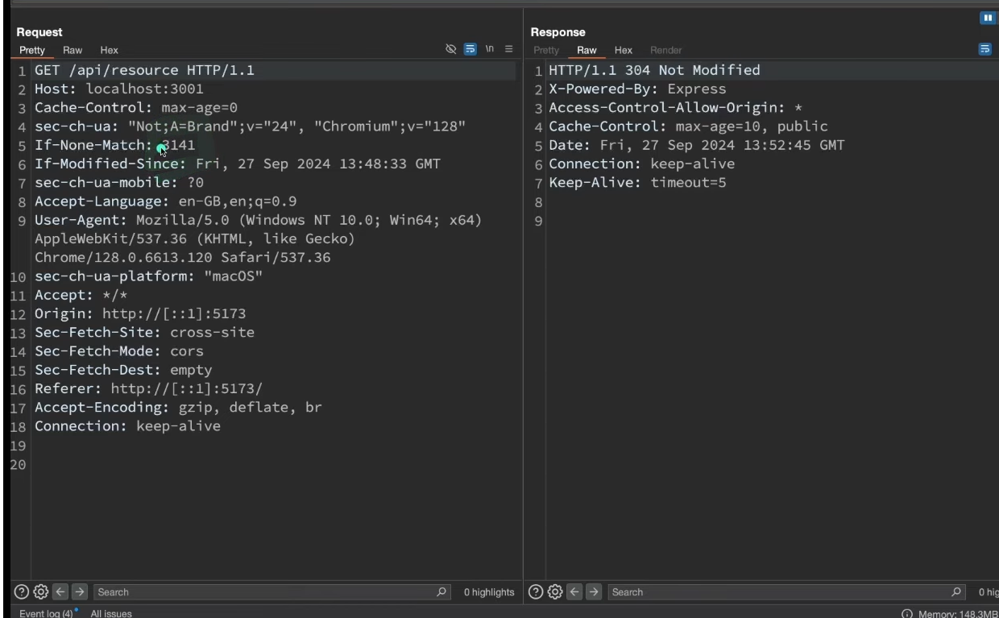

Perfect. These screenshots show **exactly what we've been talking about**. Let me break down what's happening in both requests.

---

## Image 1: First Request (200 OK - Full Response)

### **Request Side:**
```
GET /api/resource
Cache-Control: max-age=0
If-None-Match: (empty)
If-Modified-Since: (empty)
```

**What this means:**
- `Cache-Control: max-age=0` → Browser is saying "I want fresh data"
- No `If-None-Match` → Browser has no cached ETag
- No `If-Modified-Since` → Browser has no cached Last-Modified

**This is the FIRST request** (or cache was cleared).

### **Response Side:**
```
HTTP/1.1 200 OK
Cache-Control: max-age=10, public
ETag: 3141
Last-Modified: Fri, 27 Sep 2024 13:48:33 GMT
Content-Type: application/json
Content-Length: 112

{
  "content": "This is the updated resource content.",
  "lastModified": "Fri, 27 Sep 2024 13:48:33 GMT",
  "etag": "3141"
}
```

**What the server is telling the browser:**

1. **`Cache-Control: max-age=10, public`**
   - Cache this for **10 seconds**
   - Anyone can cache it (CDN, proxy, browser)

2. **`ETag: 3141`**
   - This version identifier is "3141"
   - Browser stores this for validation later

3. **`Last-Modified: Fri, 27 Sep 2024 13:48:33 GMT`**
   - Resource last changed on Sep 27, 2024
   - Browser stores this too

4. **Full body sent** (112 bytes)

**Browser now has:**
- Response body cached
- ETag: 3141
- Last-Modified: Fri, 27 Sep 2024 13:48:33 GMT
- Expiry time: now + 10 seconds

---

## Image 2: Second Request (304 Not Modified - Validation)

### **Request Side:**
```
GET /api/resource
Cache-Control: max-age=0
If-None-Match: 3141
If-Modified-Since: Fri, 27 Sep 2024 13:48:33 GMT
```

**What changed:**
- ✅ `If-None-Match: 3141` → Browser sends the ETag it stored
- ✅ `If-Modified-Since: Fri, 27 Sep 2024 13:48:33 GMT` → Browser sends the Last-Modified date

**The browser is asking:**
"I have version 3141 from Sep 27. Is it still current?"

### **Response Side:**
```
HTTP/1.1 304 Not Modified
Cache-Control: max-age=10, public
Date: Fri, 27 Sep 2024 13:52:45 GMT
```

**What the server is telling the browser:**

1. **`304 Not Modified`**
   - Your cached version (ETag 3141) is still valid
   - I'm NOT sending the body again

2. **NO BODY** (look at the response - it's empty!)
   - Saves 112 bytes
   - Browser reuses cached body

3. **New expiry:** Browser resets cache timer for another 10 seconds

---

## Key Observations

### 1. **Time Difference**
```
Request 1: 13:50:12 GMT
Request 2: 13:52:45 GMT
```

**2 minutes 33 seconds later** → Cache expired (max-age=10 seconds)

So browser **must validate** before using cache.

### 2. **ETag Validation Works**

**Server logic (pseudocode):**
```javascript
if (request.headers['if-none-match'] === currentETag) {
  return 304; // Not Modified
} else {
  return 200; // Modified, send new body
}
```

Since ETag still matches (3141 == 3141), server returns 304.

### 3. **Bandwidth Saved**

**Request 1:**
- Sent: ~500 bytes (headers)
- Received: ~112 bytes (body) + headers
- **Total: ~612 bytes**

**Request 2:**
- Sent: ~550 bytes (headers + validation)
- Received: ~200 bytes (headers only, NO BODY)
- **Total: ~750 bytes**

**Body NOT re-downloaded** → 112 bytes saved

For a 5MB image, you'd save 5MB on validation.

### 4. **Why Both If-None-Match AND If-Modified-Since?**

Browser sends BOTH for maximum compatibility:

- Modern servers use ETag (more precise)
- Older servers use Last-Modified (time-based)
- Server picks whichever it supports

**Hierarchy:**
```
If server supports ETag → use that
Else if server supports Last-Modified → use that
Else → full 200 response
```

---

## What Would Happen If...

### **Scenario A: Resource Changed**

If server updated the resource:

```
Request 3:
If-None-Match: 3141

Server checks: Current ETag is "3142" (changed!)

Response:
HTTP/1.1 200 OK
ETag: 3142
(full new body)
```

### **Scenario B: Within max-age (Fresh Cache)**

If you made Request 2 only 5 seconds after Request 1:

```
Browser thinks: Still within 10 seconds
Action: Serve from disk cache
Server: Never contacted
Network tab: Shows "from disk cache"
```

### **Scenario C: No Cache Headers**

If server sent no caching headers:

```
Response 1:
HTTP/1.1 200 OK
(no Cache-Control, no ETag)

Request 2:
(no validation headers)

Response 2:
HTTP/1.1 200 OK
(full body again)
```

Every request downloads everything.

---

## What Your Screenshots Prove

✅ **ETag validation works exactly as described**

✅ **If-None-Match carries the stored ETag**

✅ **304 means "use your cache"**

✅ **No body sent with 304 (bandwidth saved)**

✅ **Cache-Control: max-age controls when validation happens**

✅ **Last-Modified is sent alongside ETag for compatibility**

---

## The Complete Flow (From Your Screenshots)

```
Request 1 (13:50:12):
  Browser → Server: "Give me /api/resource"
  Server → Browser: "200 OK, here's the data, ETag: 3141, cache for 10s"
  Browser stores: body + ETag + Last-Modified

[Time passes: 2 minutes 33 seconds]
[Cache expired (max-age=10)]

Request 2 (13:52:45):
  Browser thinks: "Cache expired, must validate"
  Browser → Server: "Give me /api/resource, but I have ETag: 3141"
  Server checks: "ETag 3141 is still current"
  Server → Browser: "304 Not Modified, use your cached copy"
  Browser: Uses stored body from Request 1
```

---

## What You Should Now Understand

### ❌ Before:
"ETag is basically hashes"

### ✅ After:
"ETag is a version identifier (here: `3141`) stored by the browser and sent via `If-None-Match` for validation. Server returns 304 if unchanged, saving bandwidth by not re-sending the body."

### ❌ Before:
"Cache-Control: max-age"

### ✅ After:
"Cache-Control: max-age=10 tells browser to cache for 10 seconds. After expiry, browser validates using If-None-Match before reusing cache."

---

## One Final Test

**Based on these screenshots, answer:**

1. Why did Request 2 include `If-None-Match: 3141`?
2. Why was no body sent in Response 2?
3. What would happen if the server changed the resource between requests?
4. Why is the time difference 2m33s but max-age is 10s?
5. What does `Cache-Control: public` mean?

**If you can answer all 5, you understand caching.**

Want me to explain what happens with **CDN caching** or **Service Worker caching** next?

# Last-Modified: is about request or resource
**Resource. Always the resource. Never the request.**

Here’s the blunt, technical truth:

---

# ✅ **Last-Modified = timestamp of when the RESOURCE was last changed**

Not the request.
Not the endpoint.
Not the payload.
Not the query.

It strictly refers to:

**The last time the server’s underlying resource (file, object, database row, etc.) changed.**

Example:

```
Last-Modified: Wed, 10 Dec 2024 12:00:00 GMT
```

This means:

> “The thing you’re asking for was last updated at this exact time.”

---

# ❌ **What it is NOT**

It is **NOT**:

* when the request was made
* when the server responded
* when the API was deployed
* when the JSON was generated
* when the client accessed it
* when the request payload changed

None of that.

It only reflects the **resource’s own modification timestamp**.

---

# Why this matters

Because conditional requests use it:

```
If-Modified-Since: Wed, 10 Dec 2024 12:00:00 GMT
```

Server logic:

* If resource **has NOT changed since** that timestamp → **304 Not Modified**
* If resource **has changed** → **200 OK + new body**

The entire mechanism falls apart if you mix up “request time” vs “resource update time”.

---

# Summary (shortest possible)

* **Last-Modified = timestamp of resource change**
* **If-Modified-Since = client asking if that timestamp changed**
* **Never related to request timing**

If you want, I can show you real examples with files, JSON APIs, CDNs, or dynamic DB resources.


# content Negotiation

how clietn and server agree on best format to exchange data about differnt types and encoding and represenstation of the content. this ii basically a mechasi sig which client and server agree on best format to represnt data, client will tells its preference and server will try to comply with that , if not availble, a fallabck format

1. media type; client specififes the desirende hrough accept header. json, xml
2. alngruage requestion;;; sepecific language
3. encoding negotation, client tells which encoding it supports, and server responds wit appropiraote compressions

Your understanding is **correct at a high level** but sloppy in execution and missing critical details.

Let me fix this precisely:

---

## Content Negotiation - Corrected Definition

**Your version:**
"how client and server agree on best format to exchange data"

**More precise:**
```
Content negotiation is the HTTP mechanism where the client 
declares its capabilities and preferences via request headers, 
and the server selects the best representation of the resource 
from available options and responds accordingly.
```

**Key point you got right:**
✅ Client states preferences
✅ Server tries to comply
✅ Fallback if unavailable

---

## The 4 Types of Content Negotiation

You listed 3. There are actually **4 main types**:

---

### 1. **Media Type Negotiation** ✅ (You got this)

**Client declares via:**
```http
Accept: application/json, application/xml;q=0.9, */*;q=0.8
```

**What this means:**
- I prefer JSON (no quality value = 1.0 = highest priority)
- I accept XML with quality 0.9 (second preference)
- I accept anything else with quality 0.8 (lowest preference)

**Server responds with:**
```http
Content-Type: application/json

{ "data": "..." }
```

**If server can't provide JSON:**
```http
Content-Type: application/xml

<data>...</data>
```

**If server can't provide any accepted format:**
```http
HTTP/1.1 406 Not Acceptable
```

---

### 2. **Language Negotiation** ✅ (You mentioned this)

**Your version:** "specific language"

**More precise:**

**Client declares via:**
```http
Accept-Language: en-US, en;q=0.9, ar;q=0.8
```

**What this means:**
- I prefer US English (quality 1.0)
- I accept general English (quality 0.9)
- I accept Arabic (quality 0.8)

**Server responds with:**
```http
Content-Language: en-US

{ "message": "Hello" }
```

**Or if US English not available:**
```http
Content-Language: en

{ "message": "Hello" }
```

**Or fallback:**
```http
Content-Language: ar

{ "message": "مرحبا" }
```

---

### 3. **Encoding Negotiation** ✅ (You got this)

**Your version:** "client tells which encoding it supports"

**More precise:**

**Client declares via:**
```http
Accept-Encoding: gzip, deflate, br
```

**What this means:**
- I support gzip compression
- I support deflate compression
- I support Brotli (br) compression

**Server responds with:**
```http
Content-Encoding: br

[compressed binary data]
```

**Why this matters:**
```
Uncompressed: 500 KB
Gzip: 100 KB (80% reduction)
Brotli: 85 KB (83% reduction)
```

**If server doesn't support compression:**
```http
(no Content-Encoding header)

[uncompressed data]
```

---

### 4. **Charset Negotiation** ❌ (You missed this)

**Client declares via:**
```http
Accept-Charset: utf-8, iso-8859-1;q=0.7
```

**What this means:**
- I prefer UTF-8 (quality 1.0)
- I accept ISO-8859-1 (quality 0.7)

**Server responds with:**
```http
Content-Type: text/html; charset=utf-8

<!DOCTYPE html>...
```

**Why this matters:**
```
UTF-8: Supports all languages (emojis, Arabic, Chinese)
ISO-8859-1: Only Latin characters
ASCII: Only basic English
```

---

## Quality Values (q parameter) - CRITICAL

You didn't mention this at all.

**Format:**
```http
Accept: application/json;q=1.0, application/xml;q=0.8, text/plain;q=0.5
```

**Quality values (q):**
- Range: 0.0 to 1.0
- 1.0 = highest preference (default if not specified)
- 0.0 = not acceptable

**How server decides:**
```
Server has: JSON, XML, HTML

Client sends:
Accept: application/json;q=1.0, text/html;q=0.9, application/xml;q=0.5

Server picks: JSON (highest q value that server supports)
```

**If server only has XML:**
```
Server responds with XML (q=0.5 is acceptable, even if low priority)
```

---

## Real-World Examples

### **Example 1: API Request**

**Request:**
```http
GET /api/users/123
Accept: application/json
Accept-Language: en-US
Accept-Encoding: gzip, br
```

**Response:**
```http
HTTP/1.1 200 OK
Content-Type: application/json; charset=utf-8
Content-Language: en-US
Content-Encoding: br

[brotli-compressed JSON data]
```

---

### **Example 2: Browser Request**

**Request:**
```http
GET /page
Accept: text/html, application/xhtml+xml, application/xml;q=0.9, */*;q=0.8
Accept-Language: en-US, en;q=0.9, ar;q=0.8
Accept-Encoding: gzip, deflate, br
```

**Response:**
```http
HTTP/1.1 200 OK
Content-Type: text/html; charset=utf-8
Content-Language: en-US
Content-Encoding: gzip
Vary: Accept, Accept-Language, Accept-Encoding

[gzipped HTML]
```

---

### **Example 3: Server Can't Comply**

**Request:**
```http
GET /data
Accept: application/pdf
```

**Server only has JSON/XML:**
```http
HTTP/1.1 406 Not Acceptable
Content-Type: application/json

{
  "error": "Resource only available in JSON or XML",
  "available": ["application/json", "application/xml"]
}
```

---

## The Vary Header - CRITICAL (You missed this)

**Purpose:**
Tells caches which request headers affect the response.

**Example:**
```http
Vary: Accept, Accept-Language, Accept-Encoding
```

**What this means:**
"Cache separate versions based on these headers"

**Why it matters:**

```
Request 1:
Accept: application/json
→ Cached as version A

Request 2:
Accept: application/xml
→ Should NOT reuse version A
→ Cache as separate version B
```

**Without Vary:**
```
Request 1: Accept: application/json
Response: JSON (cached)

Request 2: Accept: application/xml
Cache returns: JSON (WRONG - cached response)
```

**With Vary:**
```
Request 1: Accept: application/json
Response: JSON (cached with key: Accept=json)

Request 2: Accept: application/xml
Cache miss (different Accept header)
Response: XML (cached with key: Accept=xml)
```

---

## Proactive vs Reactive Negotiation

### **Proactive (What you described)**
```
Client → "I want JSON, English, gzip"
Server → Picks best match
Server → Responds with chosen format
```

✅ Most common
✅ Single request
❌ Server decides for client

### **Reactive (Alternative)**
```
Client → "Give me /data"
Server → "I have JSON, XML, CSV - pick one"
Server → 300 Multiple Choices with list
Client → Picks preferred format
Client → Makes second request
```

❌ Less common
❌ Two requests
✅ Client has full control

---

## Common Mistakes

### ❌ 1. Not setting Content-Type in response
```javascript
// BAD
res.send({ data: "..." })

// GOOD
res.setHeader('Content-Type', 'application/json')
res.send(JSON.stringify({ data: "..." }))
```

### ❌ 2. Ignoring Accept header
```javascript
// BAD - always returns JSON
app.get('/data', (req, res) => {
  res.json({ data: "..." })
})

// GOOD - respects Accept header
app.get('/data', (req, res) => {
  res.format({
    'application/json': () => res.json({ data: "..." }),
    'application/xml': () => res.send('<data>...</data>'),
    'default': () => res.status(406).send('Not Acceptable')
  })
})
```

### ❌ 3. Missing Vary header
```javascript
// BAD - caches will break
res.setHeader('Content-Type', 'application/json')
res.send(jsonData)

// GOOD - tells caches to vary by Accept
res.setHeader('Content-Type', 'application/json')
res.setHeader('Vary', 'Accept')
res.send(jsonData)
```

### ❌ 4. Not compressing responses
```javascript
// BAD - sends 500KB uncompressed
res.send(largeData)

// GOOD - compresses based on Accept-Encoding
app.use(compression()) // Express middleware
res.send(largeData) // Automatically compressed
```

---

## Server-Side Implementation (Express Example)

```javascript
app.get('/api/resource', (req, res) => {
  const acceptHeader = req.headers.accept || '*/*';
  const acceptLanguage = req.headers['accept-language'] || 'en';
  
  // Content negotiation
  res.format({
    'application/json': () => {
      res.setHeader('Vary', 'Accept, Accept-Language');
      res.json(getDataInLanguage(acceptLanguage));
    },
    
    'application/xml': () => {
      res.setHeader('Vary', 'Accept, Accept-Language');
      res.type('xml').send(getXmlDataInLanguage(acceptLanguage));
    },
    
    'text/html': () => {
      res.setHeader('Vary', 'Accept, Accept-Language');
      res.render('data', { lang: acceptLanguage });
    },
    
    'default': () => {
      res.status(406).json({ 
        error: 'Not Acceptable',
        available: ['application/json', 'application/xml', 'text/html']
      });
    }
  });
});
```

---

## What You're Still Missing

### 1. **Quality values (q parameter)**
Critical for prioritization.

### 2. **Vary header**
Critical for caching.

### 3. **406 Not Acceptable**
What happens when server can't comply.

### 4. **Charset negotiation**
Fourth type you missed.

### 5. **Wildcard matching**
```http
Accept: text/*, */*
```

### 6. **Server-driven vs Agent-driven negotiation**
Different approaches.

---

## Corrected Summary (Use This)

```
Content negotiation is the HTTP mechanism where clients 
declare their preferences via Accept-* headers, and servers 
select the best representation from available options.

Four types:
1. Media Type (Accept → Content-Type)
2. Language (Accept-Language → Content-Language)
3. Encoding (Accept-Encoding → Content-Encoding)
4. Charset (Accept-Charset → charset parameter)

Quality values (q=0.0-1.0) prioritize preferences.
Vary header ensures proper caching.
406 Not Acceptable if server can't comply.

Critical for:
- API versioning
- Internationalization
- Performance (compression)
- Multi-format resources
```

---

## Test Your Understanding

**Answer these:**

1. What's the difference between `Accept` and `Content-Type`?
2. What does `Accept: */*` mean?
3. Why is the Vary header critical for caching?
4. What HTTP status code means "can't provide requested format"?
5. What does `application/json;q=0.5` mean?

**If you can't answer all 5, you don't understand content negotiation yet.**

Want me to explain **API versioning via content negotiation** next?

# What's the difference between Accept and Content-Type?

Here’s the clean, **no-nonsense** difference:

---

# ✅ **Accept = What the client wants to receive**

**Client → Server**

It tells the server:

> “These are the formats I am willing to accept in the RESPONSE.”

Example:

```
Accept: application/json
```

Meaning:

* “Send me JSON. If you send XML/HTML, I may reject it.”

Other examples:

```
Accept: text/html
Accept: image/png
Accept: */*
```

---

# ✅ **Content-Type = What the client is sending**

**Client → Server** (for request body)
**Server → Client** (for response body)

It tells the receiver:

> “This is the format of the data I’m sending you.”

Examples for **request**:

```
Content-Type: application/json
```

Meaning:

* “My request body is JSON.”

Examples for **response**:

```
Content-Type: text/html
Content-Type: application/pdf
```

Meaning:

* “The response body is HTML/PDF/etc.”

---

# 🔥 The difference in one sentence

**Accept = what the client wants to GET.**
**Content-Type = what the client or server is SENDING.**

---

# Real example (this clarifies everything)

### **You send a POST request:**

```
POST /api/user
Content-Type: application/json
Accept: application/json
```

Meaning:

* **Content-Type** says:
  “I’m sending you JSON data.”

* **Accept** says:
  “I want the response to also be JSON.”

The server may respond:

```
HTTP/1.1 200 OK
Content-Type: application/json
```

---

# Another example (image upload)

```
POST /upload
Content-Type: multipart/form-data
Accept: application/json
```

Meaning:

* **Content-Type:** “I'm sending a file.”
* **Accept:** “Return JSON, not HTML.”

---

# If you confuse the two, everything breaks

* If `Content-Type` is wrong → server cannot parse your body → 415 Unsupported Media Type
* If `Accept` is wrong → server may send a format you don’t support → 406 Not Acceptable

---

# Final recap (shortest possible)

* **Content-Type = describes your payload.**
* **Accept = describes your expectations.**

If you want, I can also show:

* how browsers auto-set Accept headers
* why APIs sometimes ignore Accept
* how this plays with CORS and preflight requests

Just say the word.


![Screenshot 2025-12-10 at 6.22.28 PM.png](<attachment:Screenshot 2025-12-10 at 6.22.28 PM.png>)
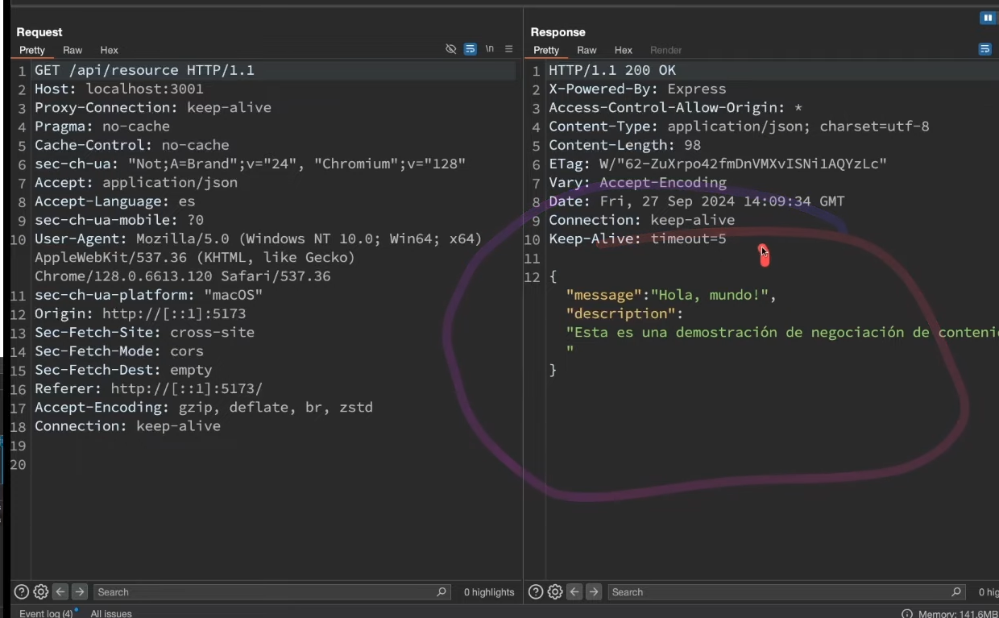

# http compression

We use compression for one reason: **to reduce the number of bytes sent over the network**. That’s it. Everything else is secondary.

Here’s the logic:

### **Why compression is needed**

* HTTP responses (HTML, CSS, JS, JSON) can be **large**.
* Network bandwidth is **slow and expensive** compared to CPU.
* Browsers don’t want to download 500 KB when they can download 80 KB.

Compression shrinks the payload:

* Faster page loads
* Less data usage
* Less server bandwidth cost
* Better Lighthouse/SEO scores

### **gzip vs deflate**

**gzip**

* Most widely supported
* Compresses using DEFLATE algorithm + adds header + checksum
* Very reliable
* Default in almost all servers

**deflate**

* Just raw DEFLATE algorithm without headers/checksum
* Historically had bugs between implementations
* Less commonly used

### **When compression applies**

* Browser sends:
  `Accept-Encoding: gzip, deflate, br`
* Server picks one (usually gzip or br)
  Returns:
  `Content-Encoding: gzip`

Browser decompresses automatically.

### **What gets compressed**

* Anything text-based:

  * HTML, CSS, JavaScript
  * JSON, XML
  * SVG
  * Plain text

**Images, videos, PDFs** → already compressed, usually not compressed again.

### **Bottom line**

Without compression, your HTTP payloads are **bloated, slow, and inefficient**. Compression is the cheapest optimization you can do for the biggest performance gain.


![Screenshot 2025-12-10 at 6.26.27 PM.png](<attachment:Screenshot 2025-12-10 at 6.26.27 PM.png>)



inital daya, http 1.0, seach request response would need a new connection, but it was not optimalsince establising and closing tcp connections is resource internsive and slow

so in http/1.1 persitsent connections were introduced, with them a single tcp coonnection can used for multiple requests response cycles. 

for acheiving that they introduced keep-alive header.

in http1.1 conncetions are presisntent by defeault



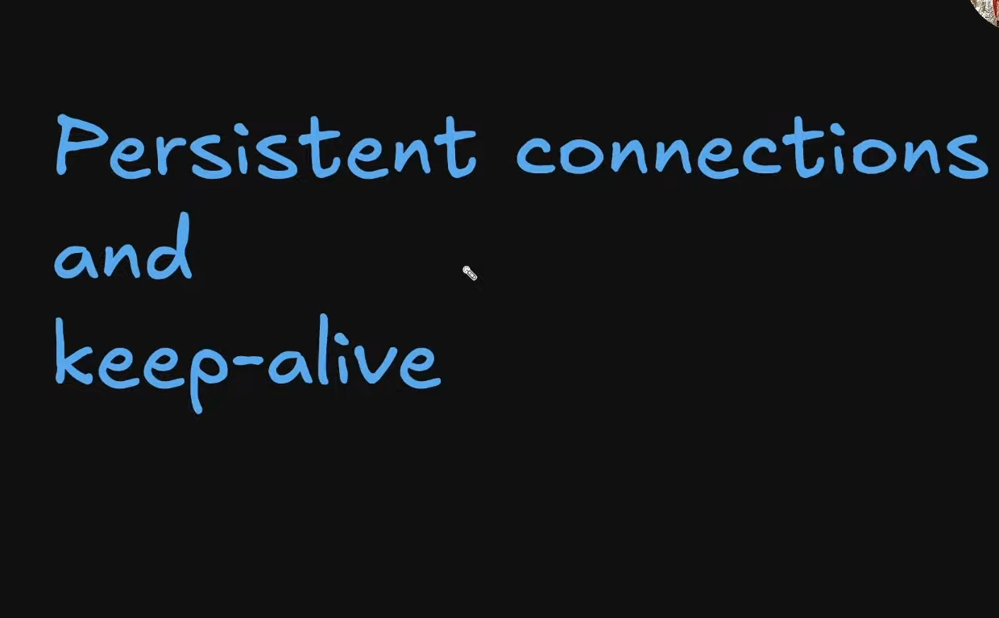

Your explanation is on the right track, but you’re mixing one detail: **HTTP/1.1 doesn’t “introduce” the Keep-Alive header — it makes persistent connections the *default***.
The header was actually from **HTTP/1.0**, not 1.1.

Here’s the clean, correct version:

---

## **HTTP/1.0**

* Every request → new TCP connection.
* TCP handshake + teardown every time = **slow** and **expensive**.
* Some servers/clients added a **non-standard header**:

  ```
  Connection: keep-alive
  ```

  This allowed reusing the same TCP connection for multiple requests.
* But behavior was inconsistent because it was not part of the core spec.

---

## **HTTP/1.1**

This is the important part:

### **1. Persistent connections became the DEFAULT**

HTTP/1.1 fixed the inefficiency by making all connections persistent unless stated otherwise.

No need to send `Connection: keep-alive`.
It’s *already assumed*.

### **2. To close the connection explicitly**

Client or server must send:

```
Connection: close
```

### **3. Why this matters**

One TCP connection can serve:

* HTML request
* CSS request
* JS request
* Images
* API calls
  …all before closing.

This reduces:

* Handshake overhead
* Latency
* CPU load
* Network congestion

---

## **Your corrected explanation**

Here is the short, correct, bulletproof version:

> In HTTP/1.0, each request opened a new TCP connection, which was slow and inefficient. Some implementations added `Connection: keep-alive` to reuse TCP connections, but it wasn’t standardized.
>
> HTTP/1.1 fixed this by making persistent connections the default. You no longer need a Keep-Alive header; instead, you only send `Connection: close` when you want to end the connection. This lets multiple request–response cycles happen on the same TCP connection and reduces overhead.

---

If you want I can rewrite your original text exactly in your style but correct.


# large requests /response

# handling last request and responses like how server takes in large files like video file, audio file which is very large compared to json and how client receives that.

1. multipart requests ;;; sending large files to server
here data is transfeered to server in parts
we are specifying  content length, our content type is multi-part form-data. and boundary

we need boundary because as our binary data would be send in parts, you want to specify a delimeter, which will separaete the part


![Screenshot 2025-12-10 at 6.33.08 PM.png](<attachment:Screenshot 2025-12-10 at 6.33.08 PM.png>)
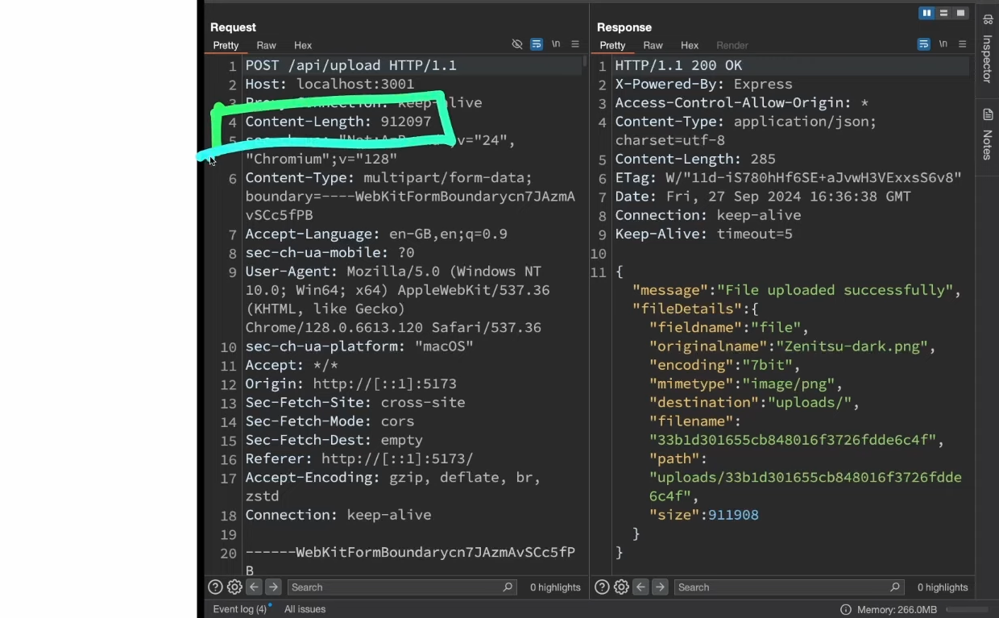

# 2. streaming responses: recieing large responese from server
sream data in chunks


1. conent-type : text/event-stream
2. connection: keep-alive

You’re mixing several concepts again. I’ll straighten them out cleanly and logically.
Here’s the correct, comprehensive breakdown — **no fluff, no feelings, just correctness**.

---

# ✅ 1. HOW LARGE FILES ARE SENT **FROM CLIENT → SERVER**

## **A. Multipart/form-data (file uploads)**

Correct idea, but your wording needs precision.

### **Why multipart exists**

* JSON can’t carry binary files efficiently.
* Large files must be chunked into *parts* within a single HTTP request.

### **How multipart/form-data works**

The request looks like this:

```
POST /upload
Content-Type: multipart/form-data; boundary=---XYZ123
Content-Length: 58291392
```

Then the body:

```
---XYZ123
Content-Disposition: form-data; name="file"; filename="video.mp4"
Content-Type: video/mp4

<binary bytes here>
---XYZ123--
```

### **Key points you MUST understand**

* **Boundary is NOT for chunking due to size.**
  It simply tells the server **where each form field begins and ends**.
* The browser sends the request body **as a continuous stream**, not manually separated “chunks”.
* Server reads the stream and identifies file boundaries from the delimiter string.

### **Multipart does NOT automatically split files for memory management.**

Chunking is handled by:

* browser networking layer
* web server (NGINX, Node.js streams, Python wsgi, etc.)

Not by the multipart format itself.

---

# **B. True streaming uploads (chunked transfer encoding)**

This is different from multipart.

Used when the client does NOT know the size (Content-Length) in advance.

```
Transfer-Encoding: chunked
```

Body arrives like:

```
4
Wiki
5
pedia
0
```

This avoids loading the entire file in memory.

---

# ✅ 2. HOW LARGE FILES ARE SENT **FROM SERVER → CLIENT**

## **A. Streaming responses (download big files, video, audio, AI output, logs, etc.)**

The server sends chunks, and the browser processes them incrementally.

Two cases:

---

## **Case 1: File downloads**

Server sets:

```
Content-Type: video/mp4
Content-Length: 200392003
```

Browser receives the file **as a stream of TCP chunks**, even though HTTP layer sends a single response.

This is just **normal HTTP**, but handled with streaming under the hood.

---

## **Case 2: Server-sent events / AI streaming / real-time messages**

This uses **text/event-stream**:

```
Content-Type: text/event-stream
Connection: keep-alive
Cache-Control: no-cache
```

Server writes:

```
data: hello
data: world
data: message 3
```

Sent progressively, no closing of connection until done.

### **This is NOT used for file downloads.**

It is used for:

* ChatGPT style streaming
* Notifications
* Real-time logs
* Live updates

---

# 🔥 FINAL SUMMARY YOU CAN USE

### **Uploading large files**

1. `multipart/form-data` → standard file uploads (HTML forms).
2. `Transfer-Encoding: chunked` → streaming upload when size unknown.

### **Downloading large files**

1. Normal HTTP response (Content-Type: video/mp4).
   Browser receives chunks at TCP level.
2. `text/event-stream` → event-by-event streaming for messages (NOT files).

---

If you want, I can draw a clean diagram showing how data flows between client → server in these cases.


# ssl vs https vs tls

ssl: orginnial protocol for securing communication between cleint and server. it encrypts data.. currently its outdated.


tls: m,odel version of ssl.  that is being used. it encripts data in transits.  data beogn sent is protected fro tampering.  it uses certificates to authnetiacate the server adn establish encrypted connection.


https is http with more securtity whihc is provieded with ssl or tls,now it is tls

https uses tls. when you visit a web using https, tls encryopts the communnication.

Here is the **clean, exact, correct explanation** — your version had the right intuition but sloppy phrasing. Fixing everything:

---

# ✅ SSL vs TLS vs HTTPS (Correct, Precise, No Nonsense)

## **1. SSL**

* **Full name:** Secure Sockets Layer
* **Purpose:** Encrypt data between client ↔ server
* **Status:** **Dead. Deprecated. Insecure.**
* **Why:** Known vulnerabilities (POODLE, BEAST, etc.)

Nobody uses SSL today. Only the name survives in phrases like “SSL certificate,” but the tech underneath is actually TLS.

---

## **2. TLS**

* **Transport Layer Security**
* **Modern, secure replacement for SSL**
* **Actively maintained & updated (TLS 1.2, TLS 1.3)**

### What TLS provides:

1. **Encryption** — your data can't be read by attackers.
2. **Integrity** — your data can't be modified without detection.
3. **Authentication** — the server proves its identity using certificates.

So the browser knows:

* you’re really talking to google.com
* data can't be intercepted or changed

TLS **is the protocol actually used today**.

---

## **3. HTTPS**

* **HTTP running over a TLS-encrypted connection.**

That’s it.
Nothing fancy.
HTTP is the application protocol.
TLS is the secure wrapper around it.

### Flow:

```
Client → (TLS handshake) → Encrypted Tunnel → HTTP request inside that tunnel
```

So:

* HTTPS ≠ new protocol
* HTTPS = HTTP + TLS
* TLS does all the security work (encryption, integrity, authentication)

---

# 🔥 FINAL SHORT VERSION (Use This)

* **SSL:** Old, broken encryption protocol. Not used anymore.
* **TLS:** Modern, secure replacement. Provides encryption + integrity + authentication.
* **HTTPS:** HTTP sent *inside* a TLS-encrypted tunnel.

So when you visit an HTTPS website, you are actually using:

```
TLS → to secure the connection  
HTTP → to send/receive data inside the encrypted tunnel
```

---

If you want, I can explain the **TLS handshake** and how the server proves its identity using certificates.
